# Importation des bibliothèques nécessaires

In [1]:
!pip install tensorflow==2.15.0 tensorflow-addons==0.23.0


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 475.3/475.3 MB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 17.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 42.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 16.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 24.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 442.0/442.0 kB 25.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.4/78.4 kB 6.1 MB/s eta 0:00:00
  Attempting uninstall: wrapt
    Found existing installation: wrapt 1.17.0
    Uninstalling wrapt-1.17.0:
      Successfully uninstalled wrapt-1.17.0
  Attempting uninstall: typeguard
    Found existing installation: typeguard 4.4.1
    Uninstalling typeguard-4.4.1:
      Successfully uninstalled typeguard-4.4.1
  Attempting uninstall: ml-dtypes
    Found existing installation: ml-dtypes 0.4.1
    Uninstalling ml-dtypes-0.4.1:
      Successfull

# Importation des bibliothèques nécessaires

In [2]:
import sys
import platform
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import warnings

import PIL
import shutil

import tensorflow as tf
import tensorflow_addons as tfa

from tensorflow import keras
from tensorflow.keras import layers


warnings.simplefilter(action = 'ignore', category = FutureWarning)
warnings.simplefilter(action = 'ignore', category = Warning)

/usr/local/lib/python3.11/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(



# Affichage des versions et configuration matérielle

In [3]:
sys.version

'3.11.11 (main, Dec  4 2024, 08:55:07) [GCC 11.4.0]'

In [4]:
tf.__version__


'2.15.0'

In [5]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [6]:
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.experimental.TPUStrategy(tpu)
except:
    strategy = tf.distribute.get_strategy()
    if tf.test.is_gpu_available():
        print("GPU is available.")
        !nvidia-smi
    else:
        print("Training on CPU.")

print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE

Instructions for updating:
Use `tf.config.list_physical_devices('GPU')` instead.


GPU is available.
Tue Jan 21 10:26:59 2025       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   44C    P0              26W /  70W |    103MiB / 15360MiB |      3%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+-------

In [8]:
try:
    # Force an error to avoid TPUs
    raise ValueError("Forcing training on CPU/GPU.")
except:
    strategy = tf.distribute.get_strategy()
    if tf.config.list_physical_devices('GPU'):
        print("GPU is available.")
    else:
        print("Training on CPU.")


GPU is available.


# Montage de Google Drive pour l'accès aux données

In [7]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


# Configuration des chemins de données

In [9]:
import os

dossier = "/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started"

elements = os.listdir(dossier)
for element in elements:
    chemin_complet = os.path.join(dossier, element)
    print(chemin_complet)



/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/photo_jpg
/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/photo_tfrec
/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/monet_jpg
/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/monet_tfrec
/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/contrast_values.csv
/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/photo_statistics.csv
/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/painting_statistics.csv
/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/generated_images
/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/photo_jpg_filtered
/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/photo_statistics_300.csv
/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/painting_statistics_300.csv
/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/variances_et_moyennes_300.csv
/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-

---
# 1) Chargement des images Monet et Photo

In [10]:
monet_paths = tf.io.gfile.glob("/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/monet_jpg/*.jpg")
photo_paths = tf.io.gfile.glob("/content/drive/MyDrive/GAN_Monet_Kaggle/gan-getting-started/photo_jpg/*.jpg")

photo_paths = photo_paths[:300]

print("Nombre d'images Monet (jpg):", len(monet_paths))
print("Nombre d'images Photo (jpg):", len(photo_paths))

IMAGE_SIZE = [256, 256]

Nombre d'images Monet (jpg): 300
Nombre d'images Photo (jpg): 300


# 2) Définition des fonctions utilitaires

In [11]:

def decode_and_resize_image(path):
    """
    Lit un chemin de fichier (image .jpg ou .png),
    puis le décode en RGB, le redimensionne en 256x256,
    et le normalise en [-1, +1].
    """
    # path est un tf.string (chemin)
    image_bytes = tf.io.read_file(path)  # Lit le fichier
    # Décoder en 3 canaux (RGB)
    img = tf.image.decode_jpeg(image_bytes, channels=3)
    # Redimensionner
    img = tf.image.resize(img, IMAGE_SIZE)
    # Normaliser en [-1, +1]
    img = (tf.cast(img, tf.float32) / 127.5) - 1.0
    return img  # shape (256, 256, 3)

def create_dataset_from_folder(filepaths):
    """
    Crée un tf.data.Dataset à partir d'une liste de chemins d'images .jpg
    """
    # On crée un dataset de chemins
    ds = tf.data.Dataset.from_tensor_slices(filepaths)
    # On mappe la fonction decode_and_resize_image
    ds = ds.map(decode_and_resize_image, num_parallel_calls=AUTOTUNE)
    return ds


In [12]:
# Chargement des datasets Monet et Photo
monet_ds_raw = create_dataset_from_folder(monet_paths)
photo_ds_raw = create_dataset_from_folder(photo_paths)

# Affichage des tailles des datasets
print("Monet images:", len(monet_paths))
print("Photo images:", len(photo_paths))


#Concatenation des datasets Monet et Photo
full_ds = monet_ds_raw.concatenate(photo_ds_raw)
total_imgs = len(monet_paths) + len(photo_paths)
print("Total images:", total_imgs)

Monet images: 300
Photo images: 300
Total images: 600


# 4) Visualisation des images

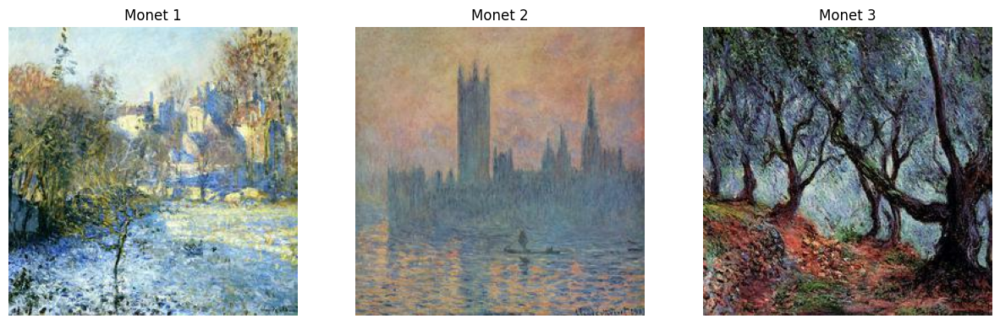

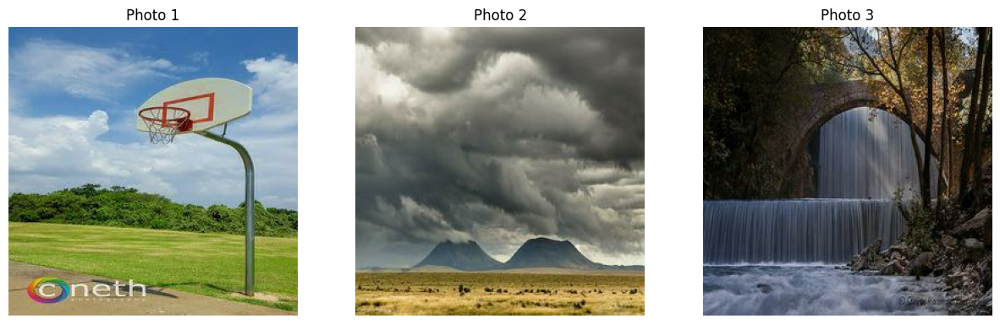

In [13]:
def display_samples(ds, title, samples=5):
    plt.figure(figsize=(5*samples, 5))
    for i, img in enumerate(ds.take(samples)):
        plt.subplot(1, samples, i+1)
        plt.title(f"{title} {i+1}")
        # Remettre l'image en [0,1] pour affichage
        plt.imshow((img + 1.0)/2.0)
        plt.axis('off')
    plt.show()

display_samples(monet_ds_raw, "Monet", samples=3)
display_samples(photo_ds_raw, "Photo", samples=3)

---
# Style GAN
---

# 5) Préparation des datasets pour l'entraînement

In [14]:
# Paramètres
BATCH_SIZE  = 32
latent_dim = 200
EPOCHS      = 50
AUTOTUNE    = tf.data.experimental.AUTOTUNE

In [15]:
# Mélange des données
full_ds = full_ds.shuffle(2000, reshuffle_each_iteration=False)

# Division en ensembles d'entraînement et de validation
train_count = int(0.8 * total_imgs)
val_count = total_imgs - train_count

train_ds_raw = full_ds.take(train_count)
val_ds_raw = full_ds.skip(train_count)

# Création des datasets batchés
train_ds = train_ds_raw.batch(BATCH_SIZE, drop_remainder=True).prefetch(AUTOTUNE)
val_ds = val_ds_raw.batch(BATCH_SIZE, drop_remainder=True).prefetch(AUTOTUNE)

print(f"Train images ~ {train_count}, Val images ~ {val_count}")

Train images ~ 480,  Val images ~ 120



# 6) Définition de la classe StyleGANGenerator


In [16]:
from tensorflow.keras import Model
from tensorflow.keras.layers import (Dense, Reshape, Conv2DTranspose,
                                     Conv2D, LeakyReLU, Flatten, Dropout)

In [17]:
class StyleGANGenerator(Model):
    def __init__(self):
        """
        Implémentation du générateur de StyleGAN basé sur des couches Conv2DTranspose.
        """
        super(StyleGANGenerator, self).__init__()
        self.dense = Dense(16 * 16 * 512, activation='relu', input_shape=(200,))
        self.reshape_layer = Reshape((16, 16, 512))
        self.deconv1 = Conv2DTranspose(256, (4, 4), strides=2, padding='same', activation='relu')
        self.deconv2 = Conv2DTranspose(128, (4, 4), strides=2, padding='same', activation='relu')
        self.deconv3 = Conv2DTranspose(64, (4, 4), strides=2, padding='same', activation='relu')
        self.deconv4 = Conv2DTranspose(3, (4, 4), strides=2, padding='same', activation='tanh')

    def call(self, z):
        """
        Méthode pour passer un vecteur latent à travers le générateur.
        """
        x = self.dense(z)
        x = self.reshape_layer(x)
        x = self.deconv1(x)
        x = self.deconv2(x)
        x = self.deconv3(x)
        x = self.deconv4(x)
        return x

# 7) Définition de la classe StyleGANDiscriminator

In [18]:
class StyleGANDiscriminator(Model):
    def __init__(self):
        """
        Implémentation du discriminateur de StyleGAN basé sur des couches Conv2D.
        """
        super(StyleGANDiscriminator, self).__init__()
        self.conv1 = Conv2D(64, (4, 4), strides=2, padding='same')
        self.lrelu1 = LeakyReLU(0.2)

        self.conv2 = Conv2D(128, (4, 4), strides=2, padding='same')
        self.norm2 = tfa.layers.InstanceNormalization(axis=-1)
        self.lrelu2 = LeakyReLU(0.2)

        self.conv3 = Conv2D(256, (4, 4), strides=2, padding='same')
        self.norm3 = tfa.layers.InstanceNormalization(axis=-1)
        self.lrelu3 = LeakyReLU(0.2)

        self.conv4 = Conv2D(512, (4, 4), strides=2, padding='same')
        self.norm4 = tfa.layers.InstanceNormalization(axis=-1)
        self.lrelu4 = LeakyReLU(0.2)

        self.flatten = Flatten()
        self.dense = Dense(1)  # logits

    def call(self, x):
        """
        Méthode pour passer une image à travers le discriminateur.
        """
        x = self.conv1(x)
        x = self.lrelu1(x)
        x = self.conv2(x)
        x = self.norm2(x)
        x = self.lrelu2(x)
        x = self.conv3(x)
        x = self.norm3(x)
        x = self.lrelu3(x)
        x = self.conv4(x)
        x = self.norm4(x)
        x = self.lrelu4(x)
        x = self.flatten(x)
        x = self.dense(x)
        return x

# 8) Initialisation des instances GAN

In [19]:
generator = StyleGANGenerator() #
discriminator = StyleGANDiscriminator()


# 9) Définition des fonctions de perte et des optimiseurs

In [20]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    """
    Perte du générateur : Encourager les outputs à être classés comme réels.
    """
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output, fake_output):
    """
    Perte du discriminateur : Distinguer correctement les vrais et faux exemples.
    """
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)


# 10) Boucle d'entraînement

In [21]:
def train_step(real_images):
    """
    Une étape d'entraînement comprenant :
    - La génération d'images.
    - L'évaluation des pertes pour le générateur et le discriminateur.
    - La mise à jour des poids via backpropagation.
    """
    batch_size_now = tf.shape(real_images)[0]
    noise = tf.random.normal([batch_size_now, latent_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(real_images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    grad_gen = gen_tape.gradient(gen_loss, generator.trainable_variables)
    grad_disc = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(grad_gen, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(grad_disc, discriminator.trainable_variables))

    return gen_loss, disc_loss

@tf.function
def val_step(real_images):
    """
    Étape de validation : Calcule les pertes sans mise à jour des poids.
    """
    batch_size_now = tf.shape(real_images)[0]
    noise = tf.random.normal([batch_size_now, latent_dim])

    generated_images = generator(noise, training=False)
    real_output = discriminator(real_images, training=False)
    fake_output = discriminator(generated_images, training=False)

    gen_loss = generator_loss(fake_output)
    disc_loss = discriminator_loss(real_output, fake_output)
    return gen_loss, disc_loss

# 11) Génération et visualisation des images

In [22]:
def generate_and_plot_images(model, epoch, num_images=5):
    """
    Génère et affiche des images à partir du générateur donné.
    """
    noise = tf.random.normal([num_images, latent_dim])
    generated_images = model(noise, training=False)  # Génération

    # Normalisation des images dans la plage [0, 1] pour affichage
    generated_images = (generated_images + 1.0) / 2.0

    # Affichage des images générées
    fig, axs = plt.subplots(1, num_images, figsize=(3 * num_images, 3))
    for i in range(num_images):
        axs[i].imshow(generated_images[i].numpy())
        axs[i].axis('off')
    plt.suptitle(f"Generated Images (Epoch {epoch})")
    plt.show()

# 12) Entraînement avec validation

In [23]:
def train_with_validation(train_ds, val_ds, epochs=20):
    # Listes pour mémoriser les pertes
    g_train = []
    d_train = []
    g_val   = []
    d_val   = []

    for epoch in range(epochs):
        # ---------- Phase train -------------
        gen_loss_acc = 0.0
        disc_loss_acc = 0.0
        steps_train = 0

        for real_batch in train_ds:
            gl, dl = train_step(real_batch)
            gen_loss_acc  += gl
            disc_loss_acc += dl
            steps_train   += 1

        gen_loss_acc  /= steps_train
        disc_loss_acc /= steps_train

        # ---------- Phase val -------------
        val_gen_loss_acc = 0.0
        val_disc_loss_acc = 0.0
        steps_val = 0

        for real_batch in val_ds:
            gl, dl = val_step(real_batch)
            val_gen_loss_acc  += gl
            val_disc_loss_acc += dl
            steps_val         += 1

        val_gen_loss_acc  /= steps_val
        val_disc_loss_acc /= steps_val

        # On stocke les pertes de cette époque
        g_train.append(gen_loss_acc.numpy())
        d_train.append(disc_loss_acc.numpy())
        g_val.append(val_gen_loss_acc.numpy())
        d_val.append(val_disc_loss_acc.numpy())

        print(f"Epoch {epoch+1}/{epochs} - "
              f"train_gen={gen_loss_acc:.4f}, train_disc={disc_loss_acc:.4f} || "
              f"val_gen={val_gen_loss_acc:.4f}, val_disc={val_disc_loss_acc:.4f}")

        # Affichage d'images toutes les 5 époques
        if (epoch+1) % 5 == 0:
            generate_and_plot_images(generator, epoch+1, num_images=5)

    # On retourne les 4 listes
    return g_train, d_train, g_val, d_val


# 13) Lancement de l'entraînement

Epoch 1/200 - train_gen=11.5039, train_disc=0.2293 || val_gen=2.8371, val_disc=1.3127
Epoch 2/200 - train_gen=15.9093, train_disc=0.2488 || val_gen=16.4822, val_disc=0.9854
Epoch 3/200 - train_gen=17.5236, train_disc=0.2443 || val_gen=37.7980, val_disc=0.5667
Epoch 4/200 - train_gen=12.5993, train_disc=0.0538 || val_gen=5.2900, val_disc=0.7872
Epoch 5/200 - train_gen=9.5030, train_disc=0.1611 || val_gen=11.5360, val_disc=0.7310


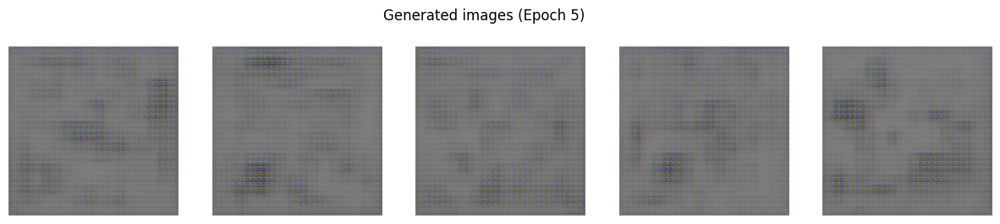

Epoch 6/200 - train_gen=8.0642, train_disc=0.1043 || val_gen=4.1238, val_disc=0.8783
Epoch 7/200 - train_gen=16.7634, train_disc=1.0767 || val_gen=27.6125, val_disc=0.6743
Epoch 8/200 - train_gen=10.8690, train_disc=0.6600 || val_gen=27.0440, val_disc=2.8898
Epoch 9/200 - train_gen=9.7779, train_disc=0.4232 || val_gen=3.2071, val_disc=0.5418
Epoch 10/200 - train_gen=11.2480, train_disc=0.6700 || val_gen=7.2755, val_disc=0.4375


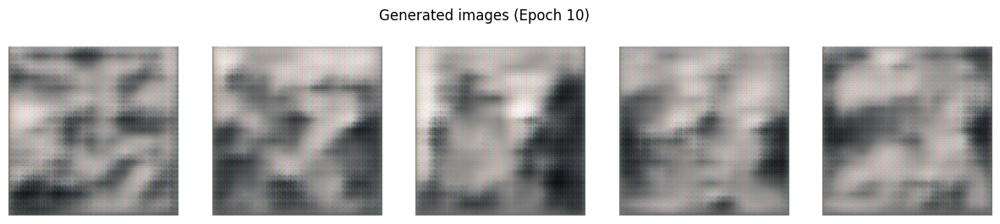

Epoch 11/200 - train_gen=7.4186, train_disc=0.2521 || val_gen=5.0559, val_disc=0.2842
Epoch 12/200 - train_gen=8.0694, train_disc=0.4833 || val_gen=15.9193, val_disc=0.2098
Epoch 13/200 - train_gen=9.0132, train_disc=0.2414 || val_gen=3.8946, val_disc=0.8351
Epoch 14/200 - train_gen=6.8119, train_disc=0.1207 || val_gen=5.7564, val_disc=0.2985
Epoch 15/200 - train_gen=9.3412, train_disc=0.7558 || val_gen=6.1071, val_disc=0.1189


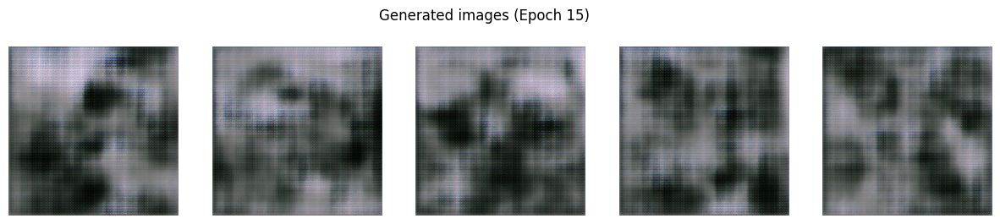

Epoch 16/200 - train_gen=7.0038, train_disc=0.5436 || val_gen=24.0061, val_disc=0.3467
Epoch 17/200 - train_gen=12.6548, train_disc=0.3570 || val_gen=8.7304, val_disc=0.6139
Epoch 18/200 - train_gen=8.4490, train_disc=0.2201 || val_gen=18.9216, val_disc=2.3791
Epoch 19/200 - train_gen=10.4079, train_disc=0.3462 || val_gen=18.5785, val_disc=0.9462
Epoch 20/200 - train_gen=8.8862, train_disc=0.1301 || val_gen=9.2196, val_disc=0.8734


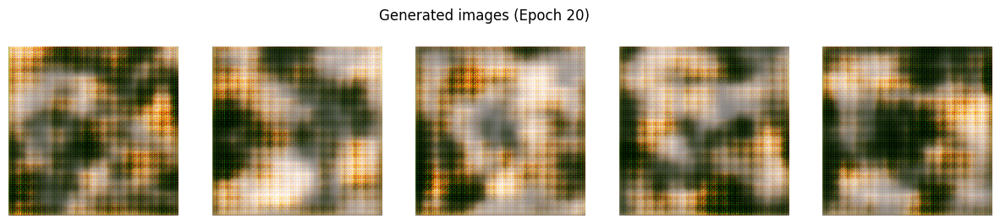

Epoch 21/200 - train_gen=7.1281, train_disc=0.2377 || val_gen=22.8268, val_disc=2.0718
Epoch 22/200 - train_gen=10.0564, train_disc=0.2785 || val_gen=8.7581, val_disc=0.5312
Epoch 23/200 - train_gen=7.4619, train_disc=0.1862 || val_gen=6.4018, val_disc=0.5325
Epoch 24/200 - train_gen=7.1793, train_disc=0.2858 || val_gen=15.1750, val_disc=1.3747
Epoch 25/200 - train_gen=9.3759, train_disc=0.5265 || val_gen=16.2251, val_disc=0.5823


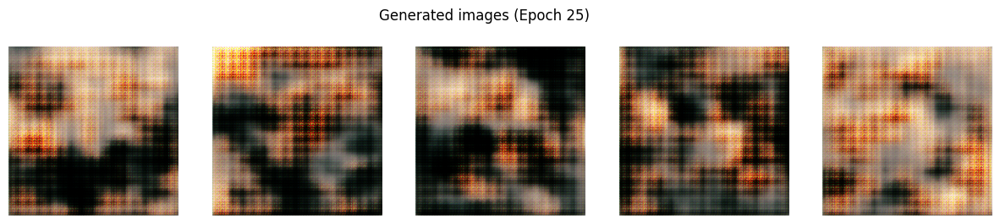

Epoch 26/200 - train_gen=8.0921, train_disc=0.2177 || val_gen=4.8733, val_disc=0.9929
Epoch 27/200 - train_gen=7.9007, train_disc=0.4090 || val_gen=7.7287, val_disc=0.4889
Epoch 28/200 - train_gen=11.3376, train_disc=1.6556 || val_gen=11.0476, val_disc=0.4446
Epoch 29/200 - train_gen=8.1233, train_disc=0.5664 || val_gen=15.1621, val_disc=1.4456
Epoch 30/200 - train_gen=9.1597, train_disc=0.4013 || val_gen=18.6919, val_disc=3.4258


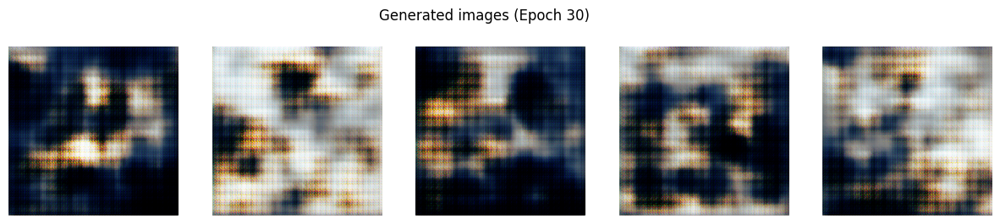

Epoch 31/200 - train_gen=8.8447, train_disc=0.2425 || val_gen=7.7966, val_disc=0.7295
Epoch 32/200 - train_gen=6.7904, train_disc=0.2234 || val_gen=27.6386, val_disc=11.9812
Epoch 33/200 - train_gen=11.6772, train_disc=1.1187 || val_gen=3.2117, val_disc=0.5659
Epoch 34/200 - train_gen=10.0797, train_disc=0.8723 || val_gen=7.1982, val_disc=0.3856
Epoch 35/200 - train_gen=7.7349, train_disc=0.7257 || val_gen=5.9501, val_disc=0.2976


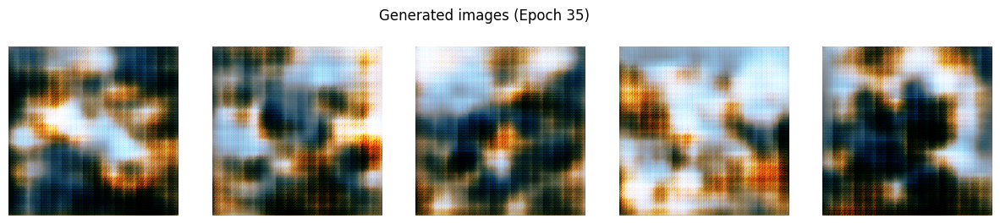

Epoch 36/200 - train_gen=7.2322, train_disc=0.5114 || val_gen=8.3507, val_disc=0.7460
Epoch 37/200 - train_gen=6.8599, train_disc=0.1712 || val_gen=1.8923, val_disc=1.1680
Epoch 38/200 - train_gen=7.8825, train_disc=1.1530 || val_gen=15.4748, val_disc=0.1009
Epoch 39/200 - train_gen=7.9100, train_disc=0.3305 || val_gen=21.4579, val_disc=6.9406
Epoch 40/200 - train_gen=9.7129, train_disc=0.7154 || val_gen=1.2228, val_disc=1.5049


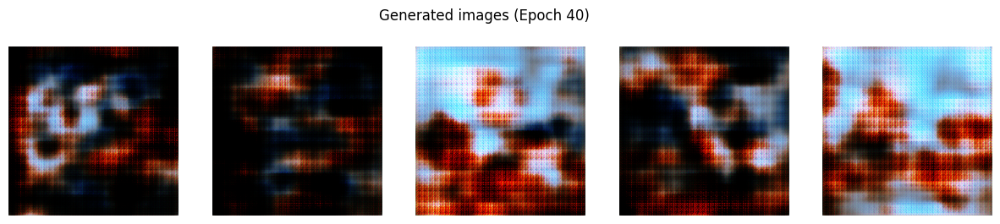

Epoch 41/200 - train_gen=8.3678, train_disc=0.3575 || val_gen=6.0882, val_disc=0.9789
Epoch 42/200 - train_gen=10.9964, train_disc=0.7692 || val_gen=4.8781, val_disc=1.2193
Epoch 43/200 - train_gen=7.2055, train_disc=0.3579 || val_gen=16.6407, val_disc=9.1042
Epoch 44/200 - train_gen=7.4782, train_disc=0.2726 || val_gen=0.4979, val_disc=2.7089
Epoch 45/200 - train_gen=8.7243, train_disc=0.5050 || val_gen=6.4312, val_disc=1.2235


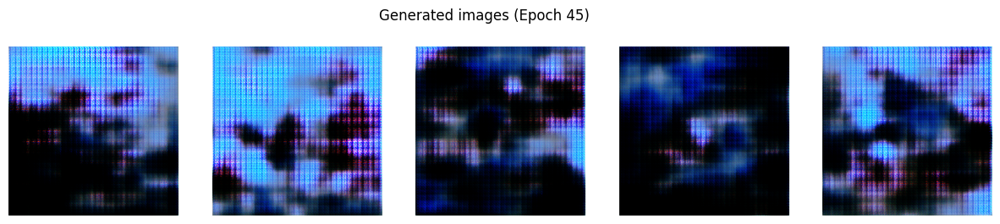

Epoch 46/200 - train_gen=6.4785, train_disc=0.0931 || val_gen=9.2493, val_disc=1.9783
Epoch 47/200 - train_gen=6.7925, train_disc=0.1980 || val_gen=4.2649, val_disc=0.5334
Epoch 48/200 - train_gen=6.2722, train_disc=0.1009 || val_gen=2.2363, val_disc=1.4800
Epoch 49/200 - train_gen=8.1799, train_disc=0.2736 || val_gen=3.2149, val_disc=1.0523
Epoch 50/200 - train_gen=5.8115, train_disc=0.0951 || val_gen=1.6462, val_disc=1.4186


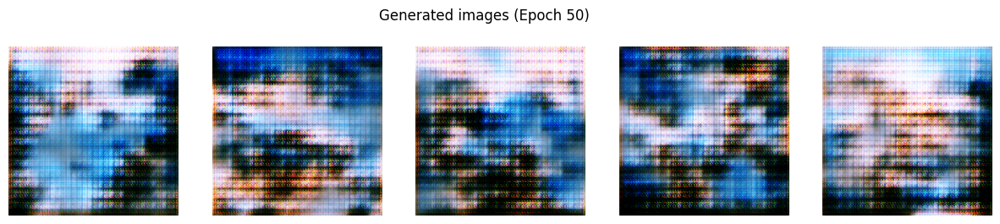

Epoch 51/200 - train_gen=8.0664, train_disc=0.1784 || val_gen=5.2674, val_disc=2.5853
Epoch 52/200 - train_gen=9.8475, train_disc=0.8066 || val_gen=11.3014, val_disc=1.8010
Epoch 53/200 - train_gen=8.2065, train_disc=0.1282 || val_gen=3.8319, val_disc=1.1670
Epoch 54/200 - train_gen=8.2660, train_disc=0.1867 || val_gen=3.1411, val_disc=0.4915
Epoch 55/200 - train_gen=5.7213, train_disc=0.0957 || val_gen=5.0802, val_disc=3.1827


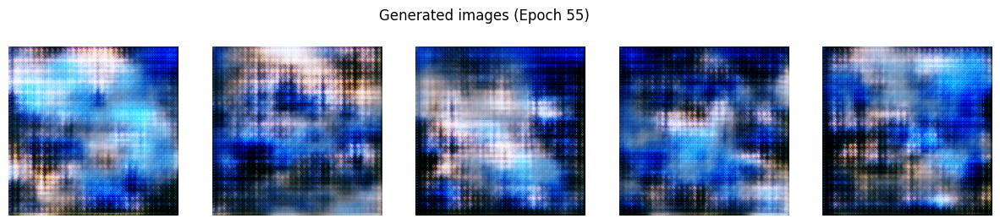

Epoch 56/200 - train_gen=6.0258, train_disc=0.1352 || val_gen=5.2093, val_disc=3.2758
Epoch 57/200 - train_gen=6.0097, train_disc=0.1101 || val_gen=4.9526, val_disc=3.1538
Epoch 58/200 - train_gen=5.5694, train_disc=0.1302 || val_gen=3.4531, val_disc=2.5617
Epoch 59/200 - train_gen=8.3636, train_disc=0.1659 || val_gen=6.3069, val_disc=3.2989
Epoch 60/200 - train_gen=9.3918, train_disc=0.6010 || val_gen=5.5712, val_disc=1.2477


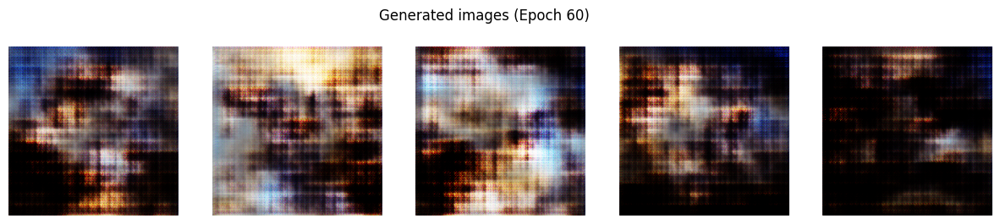

Epoch 61/200 - train_gen=8.1530, train_disc=0.1541 || val_gen=3.4653, val_disc=1.4586
Epoch 62/200 - train_gen=7.3474, train_disc=0.2367 || val_gen=4.5222, val_disc=0.9170
Epoch 63/200 - train_gen=6.0895, train_disc=0.1154 || val_gen=3.3853, val_disc=3.3843
Epoch 64/200 - train_gen=6.6859, train_disc=0.2004 || val_gen=10.6909, val_disc=4.1875
Epoch 65/200 - train_gen=7.4891, train_disc=0.1395 || val_gen=4.0240, val_disc=4.1170


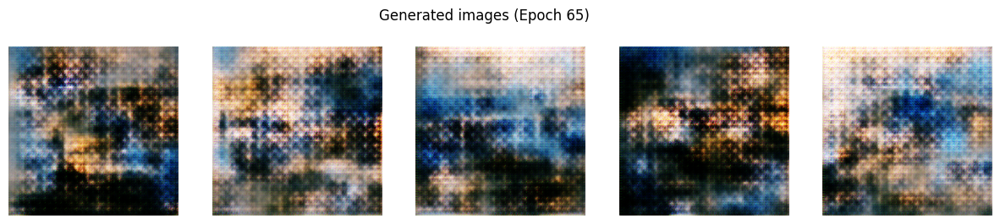

Epoch 66/200 - train_gen=6.8818, train_disc=0.1536 || val_gen=4.1032, val_disc=1.8359
Epoch 67/200 - train_gen=6.1366, train_disc=0.1505 || val_gen=3.0114, val_disc=3.6318
Epoch 68/200 - train_gen=8.7747, train_disc=0.2749 || val_gen=9.9056, val_disc=5.1124
Epoch 69/200 - train_gen=7.0942, train_disc=0.4791 || val_gen=21.7276, val_disc=4.7602
Epoch 70/200 - train_gen=11.7864, train_disc=0.7511 || val_gen=9.7452, val_disc=2.4989


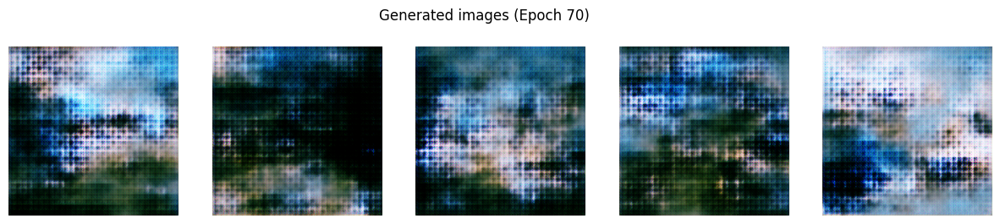

Epoch 71/200 - train_gen=7.6628, train_disc=0.4069 || val_gen=3.6532, val_disc=1.8326
Epoch 72/200 - train_gen=11.7860, train_disc=0.8520 || val_gen=1.6345, val_disc=1.8368
Epoch 73/200 - train_gen=9.3093, train_disc=0.3235 || val_gen=6.6199, val_disc=4.8794
Epoch 74/200 - train_gen=7.4213, train_disc=0.1744 || val_gen=6.8225, val_disc=7.2507
Epoch 75/200 - train_gen=8.7431, train_disc=0.2283 || val_gen=4.8973, val_disc=3.9220


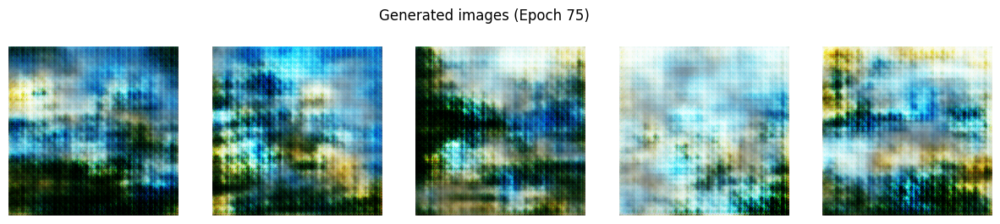

Epoch 76/200 - train_gen=6.1792, train_disc=0.2262 || val_gen=12.4992, val_disc=9.3400
Epoch 77/200 - train_gen=7.0221, train_disc=0.2530 || val_gen=1.3399, val_disc=4.3034
Epoch 78/200 - train_gen=8.3226, train_disc=0.3625 || val_gen=8.5290, val_disc=7.7953
Epoch 79/200 - train_gen=7.9697, train_disc=0.2666 || val_gen=8.2137, val_disc=6.1672
Epoch 80/200 - train_gen=9.0756, train_disc=0.2289 || val_gen=5.7018, val_disc=6.2956


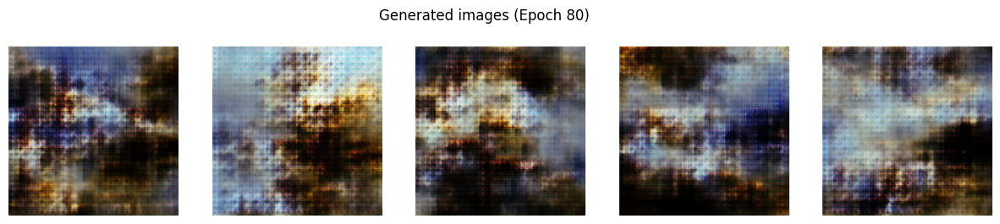

Epoch 81/200 - train_gen=8.9042, train_disc=0.8014 || val_gen=24.5686, val_disc=5.0199
Epoch 82/200 - train_gen=13.3780, train_disc=0.6051 || val_gen=6.3238, val_disc=0.1554
Epoch 83/200 - train_gen=8.1505, train_disc=0.3051 || val_gen=5.6478, val_disc=4.8402
Epoch 84/200 - train_gen=8.3987, train_disc=0.5854 || val_gen=5.8892, val_disc=4.0151
Epoch 85/200 - train_gen=7.6527, train_disc=0.2147 || val_gen=5.4295, val_disc=5.3444


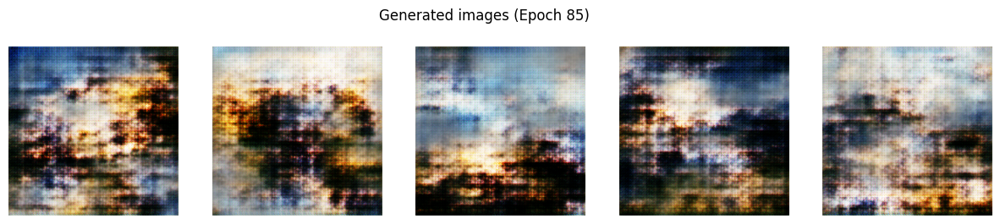

Epoch 86/200 - train_gen=11.0259, train_disc=1.0918 || val_gen=5.4103, val_disc=1.7754
Epoch 87/200 - train_gen=7.5158, train_disc=0.2988 || val_gen=14.0980, val_disc=8.0097
Epoch 88/200 - train_gen=8.3839, train_disc=0.4780 || val_gen=15.3127, val_disc=5.8474
Epoch 89/200 - train_gen=10.7157, train_disc=0.4054 || val_gen=3.9989, val_disc=4.6123
Epoch 90/200 - train_gen=9.5821, train_disc=0.7983 || val_gen=3.3237, val_disc=3.4838


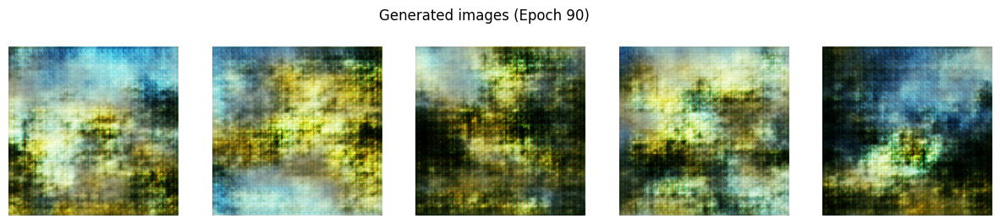

Epoch 91/200 - train_gen=9.6690, train_disc=0.6825 || val_gen=4.1106, val_disc=1.0043
Epoch 92/200 - train_gen=9.1789, train_disc=0.5417 || val_gen=0.0500, val_disc=10.5906
Epoch 93/200 - train_gen=10.7986, train_disc=1.3372 || val_gen=6.0240, val_disc=3.5772
Epoch 94/200 - train_gen=9.1743, train_disc=0.5942 || val_gen=7.8313, val_disc=8.4678
Epoch 95/200 - train_gen=10.9580, train_disc=1.1298 || val_gen=12.7502, val_disc=11.2786


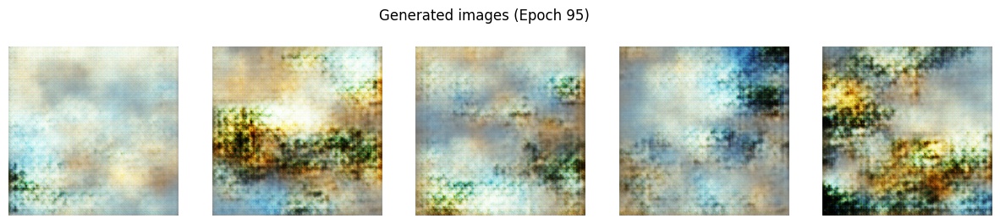

Epoch 96/200 - train_gen=9.5257, train_disc=1.1233 || val_gen=7.5018, val_disc=5.9128
Epoch 97/200 - train_gen=8.9612, train_disc=0.7740 || val_gen=7.3706, val_disc=5.7139
Epoch 98/200 - train_gen=6.2465, train_disc=0.3997 || val_gen=7.2329, val_disc=7.0043
Epoch 99/200 - train_gen=7.8750, train_disc=0.5398 || val_gen=8.2047, val_disc=7.1724
Epoch 100/200 - train_gen=8.2570, train_disc=0.5711 || val_gen=5.2685, val_disc=7.0349


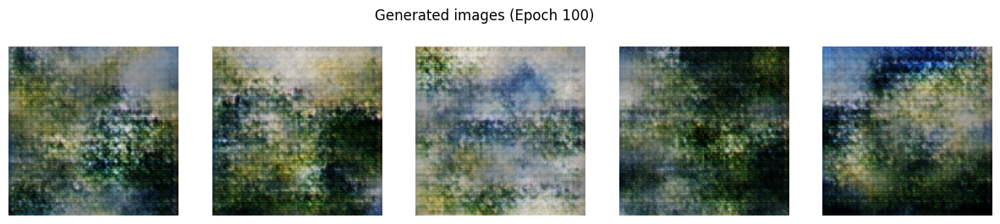

Epoch 101/200 - train_gen=6.6365, train_disc=0.4317 || val_gen=6.4459, val_disc=6.1403
Epoch 102/200 - train_gen=7.4595, train_disc=0.7263 || val_gen=10.2545, val_disc=5.4182
Epoch 103/200 - train_gen=9.6453, train_disc=1.1561 || val_gen=11.3110, val_disc=8.9918
Epoch 104/200 - train_gen=7.4287, train_disc=0.5502 || val_gen=6.1143, val_disc=5.3031
Epoch 105/200 - train_gen=8.1636, train_disc=1.0237 || val_gen=4.8926, val_disc=4.2239


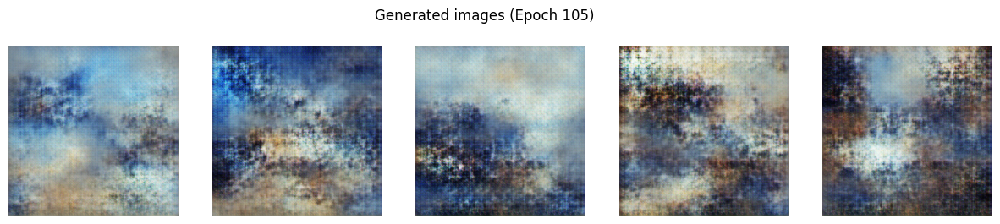

Epoch 106/200 - train_gen=6.3323, train_disc=0.5047 || val_gen=10.0875, val_disc=9.0544
Epoch 107/200 - train_gen=10.1024, train_disc=1.0597 || val_gen=10.1345, val_disc=3.0898
Epoch 108/200 - train_gen=7.9443, train_disc=0.6813 || val_gen=6.1710, val_disc=3.7721
Epoch 109/200 - train_gen=7.4380, train_disc=0.7289 || val_gen=1.7339, val_disc=4.1002
Epoch 110/200 - train_gen=7.9070, train_disc=0.7198 || val_gen=13.1471, val_disc=6.5743


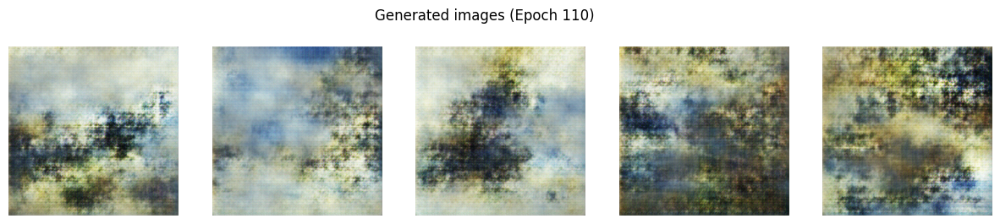

Epoch 111/200 - train_gen=7.4919, train_disc=0.6104 || val_gen=8.0098, val_disc=4.8065
Epoch 112/200 - train_gen=8.1351, train_disc=0.8662 || val_gen=16.9283, val_disc=7.7321
Epoch 113/200 - train_gen=8.8841, train_disc=0.7904 || val_gen=2.8121, val_disc=3.7023
Epoch 114/200 - train_gen=6.8329, train_disc=0.5989 || val_gen=8.3836, val_disc=7.1173
Epoch 115/200 - train_gen=7.6895, train_disc=0.7862 || val_gen=5.3948, val_disc=4.8148


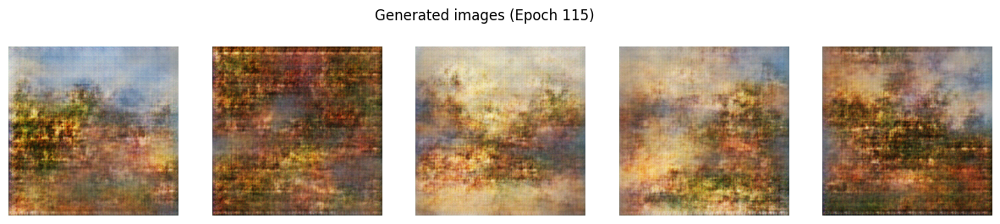

Epoch 116/200 - train_gen=7.3040, train_disc=0.6737 || val_gen=6.9847, val_disc=5.8954
Epoch 117/200 - train_gen=9.2038, train_disc=1.2904 || val_gen=7.9494, val_disc=2.2384
Epoch 118/200 - train_gen=8.0366, train_disc=1.0398 || val_gen=19.4909, val_disc=10.3006
Epoch 119/200 - train_gen=7.4842, train_disc=0.4045 || val_gen=5.9358, val_disc=10.2147
Epoch 120/200 - train_gen=6.7590, train_disc=0.9984 || val_gen=12.0800, val_disc=10.5141


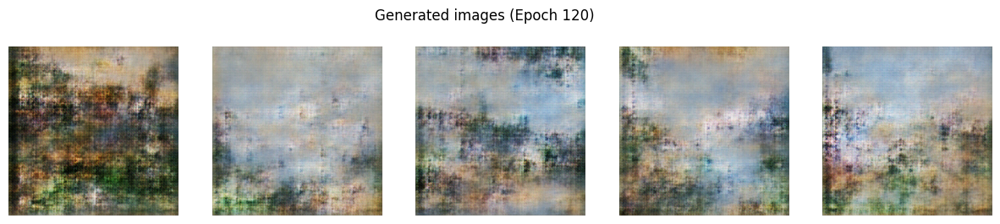

Epoch 121/200 - train_gen=6.4374, train_disc=0.5920 || val_gen=4.7910, val_disc=8.9646
Epoch 122/200 - train_gen=6.8581, train_disc=0.6824 || val_gen=1.7663, val_disc=6.7446
Epoch 123/200 - train_gen=7.8708, train_disc=0.8536 || val_gen=13.0300, val_disc=8.1164
Epoch 124/200 - train_gen=6.8112, train_disc=0.4533 || val_gen=5.8043, val_disc=7.9575
Epoch 125/200 - train_gen=5.7090, train_disc=0.5095 || val_gen=6.5650, val_disc=10.2594


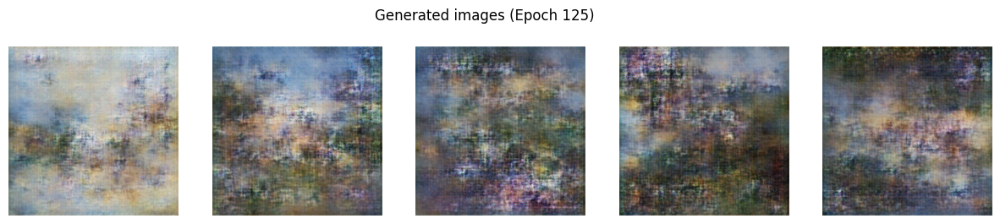

Epoch 126/200 - train_gen=6.6314, train_disc=0.6301 || val_gen=7.7417, val_disc=8.8162
Epoch 127/200 - train_gen=6.7629, train_disc=0.6142 || val_gen=13.1366, val_disc=13.5858
Epoch 128/200 - train_gen=8.2809, train_disc=1.0282 || val_gen=4.6418, val_disc=5.7375
Epoch 129/200 - train_gen=7.5737, train_disc=1.0026 || val_gen=4.2098, val_disc=7.3170
Epoch 130/200 - train_gen=7.6565, train_disc=1.2084 || val_gen=7.8092, val_disc=5.2338


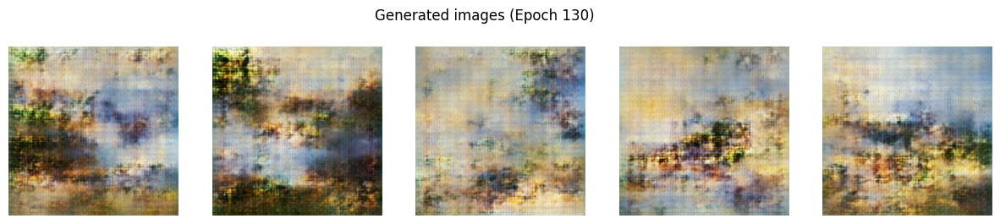

Epoch 131/200 - train_gen=6.6135, train_disc=0.7629 || val_gen=5.3437, val_disc=6.0870
Epoch 132/200 - train_gen=5.1355, train_disc=0.6755 || val_gen=14.6127, val_disc=12.4351
Epoch 133/200 - train_gen=7.3289, train_disc=0.6146 || val_gen=9.3209, val_disc=10.1560
Epoch 134/200 - train_gen=6.6768, train_disc=0.5544 || val_gen=3.0240, val_disc=7.2498
Epoch 135/200 - train_gen=6.4878, train_disc=0.7214 || val_gen=4.5280, val_disc=5.8643


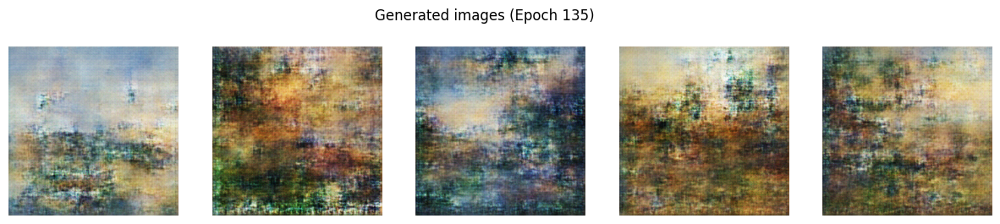

Epoch 136/200 - train_gen=4.9851, train_disc=0.4958 || val_gen=10.2969, val_disc=9.9002
Epoch 137/200 - train_gen=7.2918, train_disc=0.7257 || val_gen=1.0270, val_disc=6.1840
Epoch 138/200 - train_gen=8.1471, train_disc=0.6668 || val_gen=8.5518, val_disc=10.6778
Epoch 139/200 - train_gen=5.5694, train_disc=0.3643 || val_gen=3.8605, val_disc=9.2634
Epoch 140/200 - train_gen=6.2089, train_disc=0.7661 || val_gen=3.1175, val_disc=7.2933


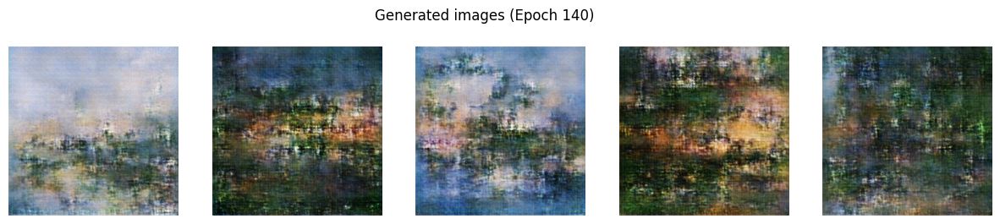

Epoch 141/200 - train_gen=5.3274, train_disc=0.3960 || val_gen=8.8751, val_disc=11.9057
Epoch 142/200 - train_gen=7.0155, train_disc=1.1698 || val_gen=11.1025, val_disc=8.7175
Epoch 143/200 - train_gen=6.5454, train_disc=0.5559 || val_gen=5.3202, val_disc=8.1315
Epoch 144/200 - train_gen=6.5714, train_disc=1.1684 || val_gen=2.0082, val_disc=7.4075
Epoch 145/200 - train_gen=6.5560, train_disc=0.6486 || val_gen=4.4621, val_disc=9.3056


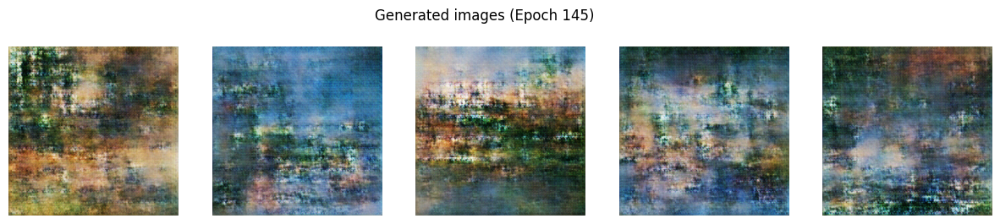

Epoch 146/200 - train_gen=5.0942, train_disc=0.4876 || val_gen=8.4379, val_disc=11.5001
Epoch 147/200 - train_gen=5.5560, train_disc=0.3903 || val_gen=1.5201, val_disc=7.7340
Epoch 148/200 - train_gen=6.7493, train_disc=0.6715 || val_gen=3.8733, val_disc=7.5926
Epoch 149/200 - train_gen=6.0757, train_disc=0.7377 || val_gen=7.7136, val_disc=8.6481
Epoch 150/200 - train_gen=5.2669, train_disc=0.3988 || val_gen=13.2517, val_disc=12.7034


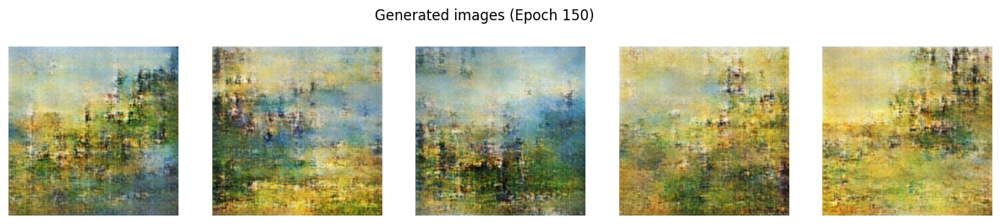

Epoch 151/200 - train_gen=6.4517, train_disc=0.4371 || val_gen=0.3746, val_disc=7.2186
Epoch 152/200 - train_gen=7.2792, train_disc=0.5999 || val_gen=6.0921, val_disc=9.8928
Epoch 153/200 - train_gen=6.4635, train_disc=0.9094 || val_gen=15.8448, val_disc=12.4649
Epoch 154/200 - train_gen=7.3671, train_disc=0.5179 || val_gen=5.9696, val_disc=8.6002
Epoch 155/200 - train_gen=5.7538, train_disc=0.9969 || val_gen=8.7611, val_disc=7.2280


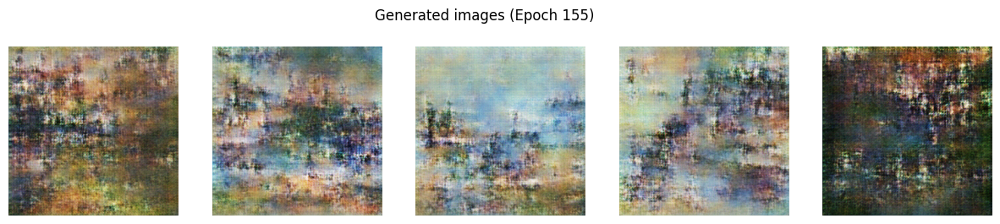

Epoch 156/200 - train_gen=6.0715, train_disc=0.4284 || val_gen=18.2212, val_disc=12.8038
Epoch 157/200 - train_gen=8.7430, train_disc=0.5151 || val_gen=6.0682, val_disc=9.2331
Epoch 158/200 - train_gen=5.6236, train_disc=0.2226 || val_gen=5.7353, val_disc=10.5396
Epoch 159/200 - train_gen=5.3787, train_disc=0.3792 || val_gen=8.3473, val_disc=12.0880
Epoch 160/200 - train_gen=4.5356, train_disc=0.2998 || val_gen=8.9115, val_disc=12.2463


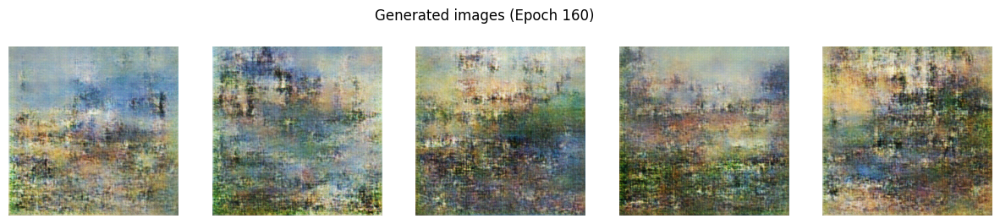

Epoch 161/200 - train_gen=7.4374, train_disc=0.6574 || val_gen=3.9213, val_disc=9.1566
Epoch 162/200 - train_gen=7.5695, train_disc=1.0862 || val_gen=7.4916, val_disc=6.0919
Epoch 163/200 - train_gen=6.4933, train_disc=0.5436 || val_gen=5.0218, val_disc=8.4518
Epoch 164/200 - train_gen=5.5439, train_disc=0.5290 || val_gen=6.7838, val_disc=8.4690
Epoch 165/200 - train_gen=5.8244, train_disc=0.6192 || val_gen=10.7748, val_disc=10.2667


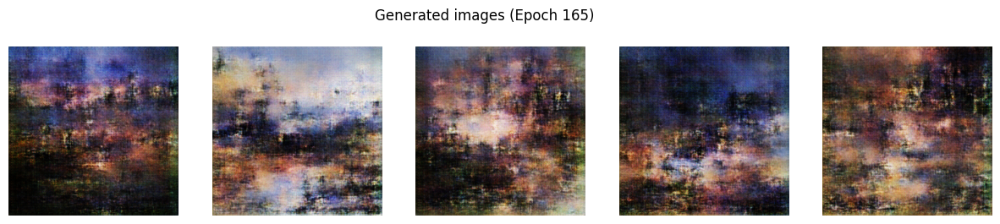

Epoch 166/200 - train_gen=5.5183, train_disc=0.3034 || val_gen=9.1818, val_disc=10.6208
Epoch 167/200 - train_gen=5.7487, train_disc=0.3191 || val_gen=0.6105, val_disc=7.8272
Epoch 168/200 - train_gen=6.2887, train_disc=0.5002 || val_gen=5.7610, val_disc=11.0797
Epoch 169/200 - train_gen=6.4585, train_disc=0.6445 || val_gen=6.8638, val_disc=9.3877
Epoch 170/200 - train_gen=6.1169, train_disc=0.3267 || val_gen=5.1427, val_disc=9.2328


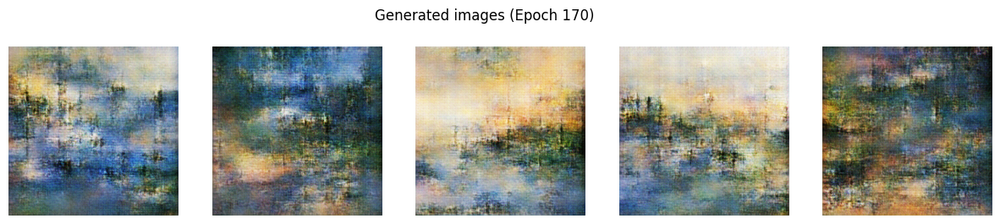

Epoch 171/200 - train_gen=5.2054, train_disc=0.2057 || val_gen=4.4438, val_disc=9.7342
Epoch 172/200 - train_gen=5.5848, train_disc=0.3289 || val_gen=6.5260, val_disc=9.2434
Epoch 173/200 - train_gen=6.4617, train_disc=0.6299 || val_gen=0.9531, val_disc=5.6250
Epoch 174/200 - train_gen=7.1969, train_disc=0.4488 || val_gen=6.2792, val_disc=8.8159
Epoch 175/200 - train_gen=6.7358, train_disc=0.2823 || val_gen=5.9826, val_disc=10.0009


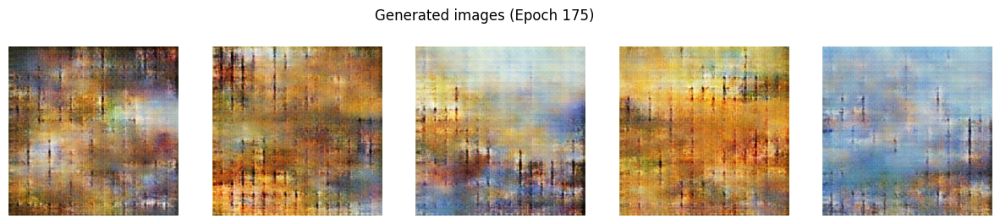

Epoch 176/200 - train_gen=5.3905, train_disc=0.1304 || val_gen=4.3409, val_disc=9.6992
Epoch 177/200 - train_gen=5.1319, train_disc=0.2631 || val_gen=6.2132, val_disc=11.2333
Epoch 178/200 - train_gen=5.9386, train_disc=0.7470 || val_gen=11.0503, val_disc=10.8259
Epoch 179/200 - train_gen=5.8270, train_disc=0.2291 || val_gen=5.2407, val_disc=10.2192
Epoch 180/200 - train_gen=5.4349, train_disc=0.2443 || val_gen=7.8035, val_disc=10.5838


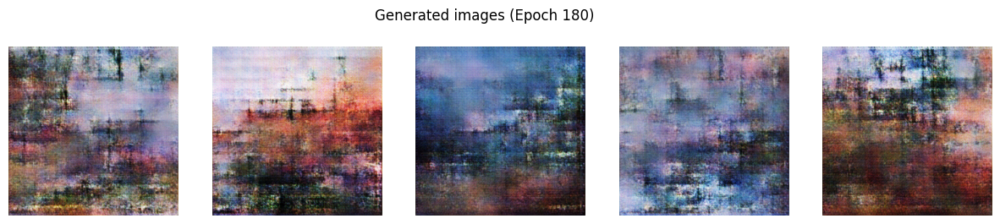

Epoch 181/200 - train_gen=5.2525, train_disc=0.1875 || val_gen=6.0938, val_disc=10.6990
Epoch 182/200 - train_gen=5.1661, train_disc=0.1601 || val_gen=5.1877, val_disc=10.7406
Epoch 183/200 - train_gen=4.9707, train_disc=0.1717 || val_gen=7.5642, val_disc=12.6718
Epoch 184/200 - train_gen=5.0786, train_disc=0.1707 || val_gen=5.9637, val_disc=10.2907
Epoch 185/200 - train_gen=5.8327, train_disc=0.2011 || val_gen=6.3030, val_disc=9.4782


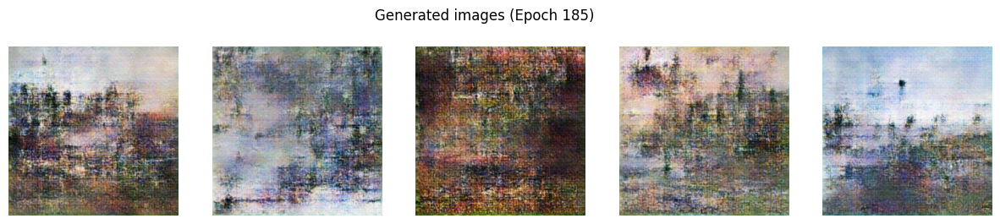

Epoch 186/200 - train_gen=5.2989, train_disc=0.1561 || val_gen=5.5118, val_disc=9.4892
Epoch 187/200 - train_gen=6.4505, train_disc=0.3023 || val_gen=1.2121, val_disc=7.5382
Epoch 188/200 - train_gen=7.0235, train_disc=0.5322 || val_gen=5.8160, val_disc=8.4722
Epoch 189/200 - train_gen=5.4100, train_disc=0.1586 || val_gen=4.3239, val_disc=7.3359
Epoch 190/200 - train_gen=5.8244, train_disc=0.1516 || val_gen=5.5232, val_disc=10.7084


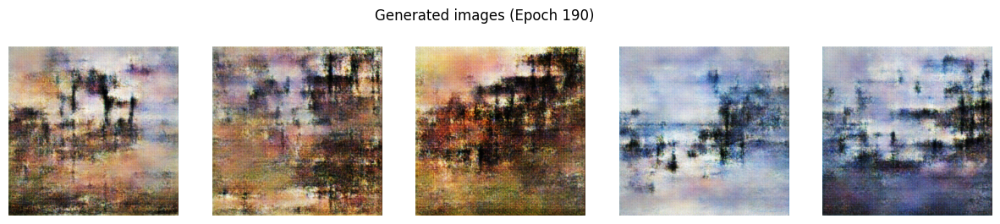

Epoch 191/200 - train_gen=5.7059, train_disc=0.2270 || val_gen=5.9838, val_disc=10.3581
Epoch 192/200 - train_gen=5.5704, train_disc=0.1587 || val_gen=7.7318, val_disc=10.3411
Epoch 193/200 - train_gen=5.3694, train_disc=0.2047 || val_gen=5.6370, val_disc=9.2282
Epoch 194/200 - train_gen=5.6426, train_disc=0.1398 || val_gen=3.7411, val_disc=8.8691
Epoch 195/200 - train_gen=5.5927, train_disc=0.1208 || val_gen=6.5876, val_disc=10.0855


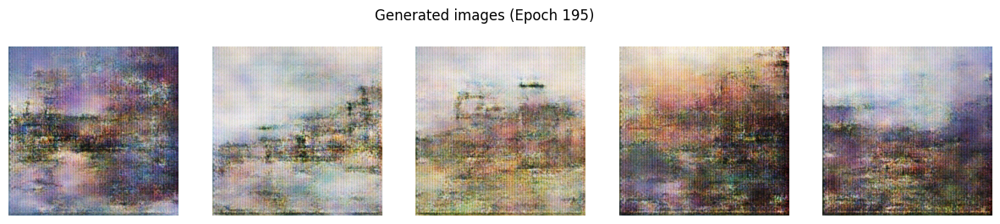

Epoch 196/200 - train_gen=5.7191, train_disc=0.0825 || val_gen=7.8848, val_disc=9.0866
Epoch 197/200 - train_gen=7.7367, train_disc=0.4442 || val_gen=5.0299, val_disc=6.5194
Epoch 198/200 - train_gen=8.6185, train_disc=1.3925 || val_gen=6.3655, val_disc=6.3746
Epoch 199/200 - train_gen=9.0723, train_disc=1.6259 || val_gen=8.9413, val_disc=7.9092
Epoch 200/200 - train_gen=6.7119, train_disc=0.2960 || val_gen=4.0503, val_disc=6.5621


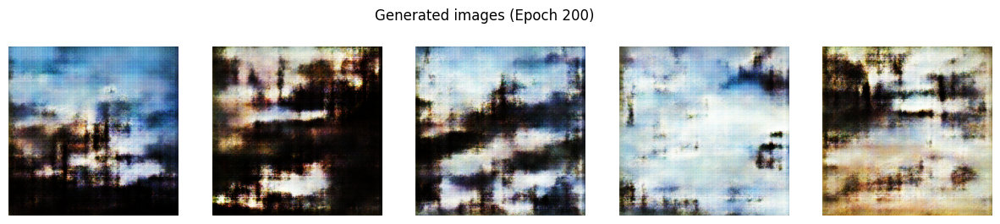

In [26]:
EPOCHS = 200
g_train, d_train, g_val, d_val = train_with_validation(train_ds, val_ds, epochs=EPOCHS)


# 14) Tracé des courbes de perte

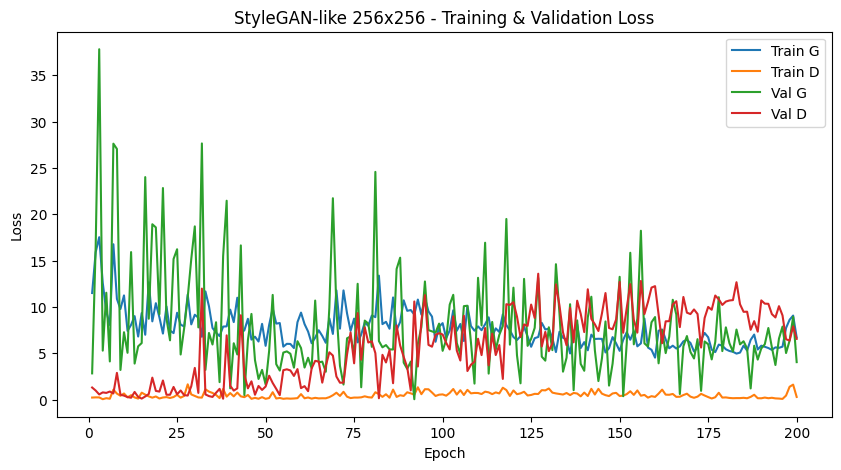

In [27]:

plt.figure(figsize=(10,5))
plt.plot(range(1,EPOCHS+1), g_train, label="Train G")
plt.plot(range(1,EPOCHS+1), d_train, label="Train D")
plt.plot(range(1,EPOCHS+1), g_val,   label="Val G")
plt.plot(range(1,EPOCHS+1), d_val,   label="Val D")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.title("StyleGAN-like 256x256 - Training & Validation Loss")
plt.legend()
plt.show()

# 15) Test de génération finale

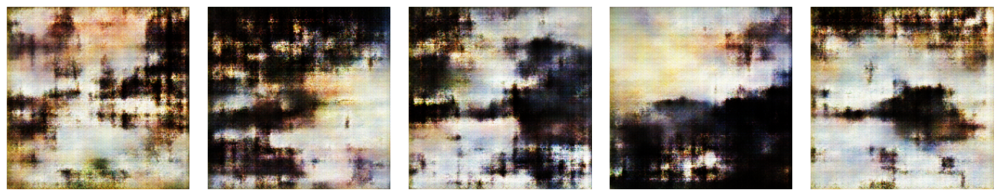

In [49]:

def test_generation(generator, latent_dim=200, num_images=5):
    noise = tf.random.normal([num_images, latent_dim])
    gen_imgs = generator(noise, training=False)
    gen_imgs = (gen_imgs + 1)/2.0  # [0,1]
    plt.figure(figsize=(3*num_images,3))
    for i in range(num_images):
        plt.subplot(1, num_images, i+1)
        plt.imshow(gen_imgs[i].numpy())
        plt.axis('off')
    plt.tight_layout()
    plt.show()

test_generation(generator, latent_dim=latent_dim, num_images=5)

In [55]:
import matplotlib.pyplot as plt
import tensorflow as tf

def test_generator(generator, latent_dim=200, num_images=5):
    random_noise = tf.random.normal([num_images, latent_dim])
    generated_images = generator(random_noise, training=False)
    generated_images = (generated_images + 1) / 2.0

    # Fix: Adjust rows and cols to match latent_dim
    rows, cols = 10, 20  # Now rows * cols = 200, matching latent_dim

    fig, axs = plt.subplots(2, num_images, figsize=(4*num_images, 6))
    for i in range(num_images):
        noise_2d = tf.reshape(random_noise[i], (rows, cols))

        axs[0, i].imshow(noise_2d, cmap='gray')
        axs[0, i].set_title("Bruit (10x20)") # Update title to reflect new shape
        axs[0, i].axis('off')

        axs[1, i].imshow(generated_images[i].numpy())
        axs[1, i].set_title("Image générée")
        axs[1, i].axis('off')

    plt.tight_layout()
    plt.show()

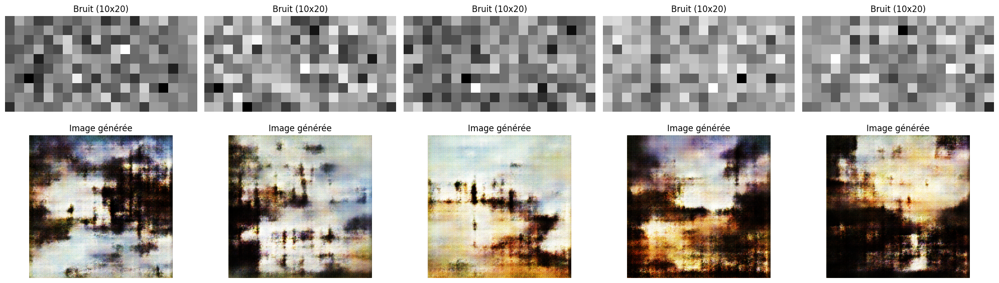

In [57]:
# Par exemple, après 50 epochs, on fait un test
test_generator(generator, latent_dim=latent_dim, num_images=5) # Use LATENT_DIM instead of 100

In [58]:
def test_discriminator(discriminator, generator, real_dataset, latent_dim=100, num_images=3):
    """
    Teste le discriminateur :
    - Prend un lot de real_dataset,
    - N'en extrait 'num_images',
    - Génère 'num_images' fake,
    - Evalue tout ça dans le Discriminateur
    """
    # Récupère un lot (de 64, par exemple)
    real_batch = next(iter(real_dataset))  # shape (64,256,256,3)
    # On prend juste 3 images
    real_batch = real_batch[:num_images]   # shape (3,256,256,3)

    noise = tf.random.normal([num_images, latent_dim])
    fake_batch = generator(noise, training=False)

    real_logits = discriminator(real_batch, training=False)
    fake_logits = discriminator(fake_batch, training=False)

    print("Logits pour VRAIES images :")
    print(real_logits.numpy())
    print("\nLogits pour FAUSSES images :")
    print(fake_logits.numpy())

    # (Optionnel) Visualiser
    real_disp = (real_batch + 1)/2.0
    fake_disp = (fake_batch + 1)/2.0

    fig, axs = plt.subplots(2, num_images, figsize=(3*num_images,6))
    for i in range(num_images):
        axs[0,i].imshow(real_disp[i].numpy())
        axs[0,i].set_title("Real")
        axs[0,i].axis('off')

        axs[1,i].imshow(fake_disp[i].numpy())
        axs[1,i].set_title("Fake")
        axs[1,i].axis('off')
    plt.tight_layout()
    plt.show()


Logits pour VRAIES images :
[[8.019674 ]
 [4.0475254]
 [7.5723143]]

Logits pour FAUSSES images :
[[-4.917577 ]
 [-1.7919527]
 [-4.127987 ]]


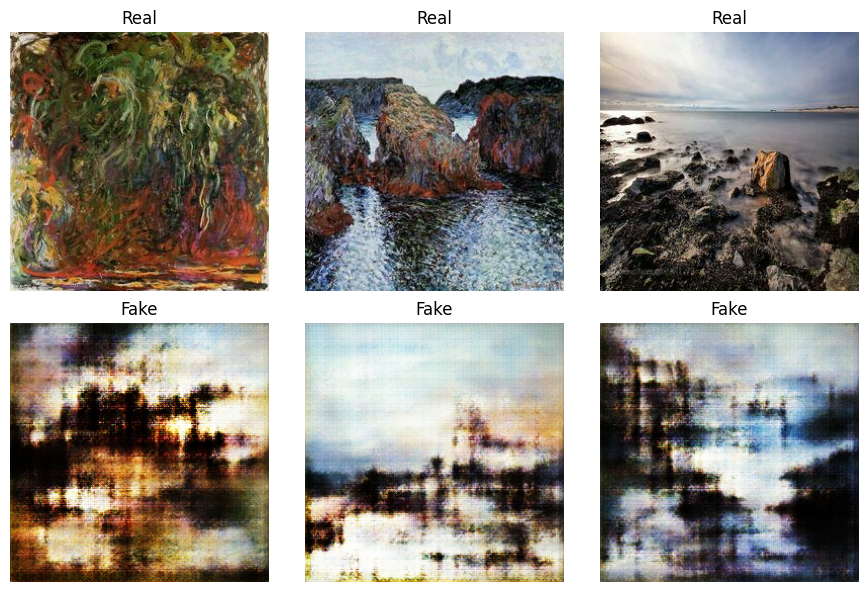

In [73]:
test_discriminator(discriminator, generator, real_dataset=train_ds, latent_dim=200, num_images=3)


# 16)Sauvegarde des modèles

In [29]:
# ====================================================
#Sauvegarde des modèles
# ====================================================
generator.save("/content/drive/MyDrive/GAN_Monet_Kaggle/Model/StyleGAN_2/generator_saved_model")  # Crée un dossier "generator_saved_model"
discriminator.save("/content/drive/MyDrive/GAN_Monet_Kaggle/Model/StyleGAN_2/discriminator_saved_model")


In [ ]:
# Recréer exactement la même classe / architecture
generator = StyleGANGenerator()
discriminator = StyleGANDiscriminator()

# Charger les poids
generator.load_weights("/content/drive/MyDrive/GAN_Monet_Kaggle/Model/StyleGAN_2/generator_saved_model/generator_weights.h5")
discriminator.load_weights("/content/drive/MyDrive/GAN_Monet_Kaggle/Model/StyleGAN_2/discriminator_saved_model")


---
# STAR GAN
---
1) Préparation des données pour StarGAN


In [94]:
BATCH_SIZE = 8
AUTOTUNE   = tf.data.experimental.AUTOTUNE


In [120]:


# On les recharge
monet_ds_raw = create_dataset_from_folder(monet_paths)
photo_ds_raw = create_dataset_from_folder(photo_paths)

# Fonction de labellisation
def label_monet(img):
    # Monet => [0,1]
    return img, tf.constant([0.,1.], dtype=tf.float32)

def label_photo(img):
    # Photo => [1,0]
    return img, tf.constant([1.,0.], dtype=tf.float32)

def create_labeled_dataset(img_paths, label_fn):
    ds = tf.data.Dataset.from_tensor_slices(img_paths)
    ds = ds.map(decode_and_resize_image, num_parallel_calls=AUTOTUNE)
    ds = ds.map(label_fn, num_parallel_calls=AUTOTUNE)
    return ds


# On crée d'abord le dataset "raw" (images seules)
monet_ds_raw = create_dataset_from_folder(monet_paths)
photo_ds_raw = create_dataset_from_folder(photo_paths)

# Puis on ajoute le label
monet_ds_labeled = monet_ds_raw.map(label_monet, num_parallel_calls=AUTOTUNE)
photo_ds_labeled = photo_ds_raw.map(label_photo, num_parallel_calls=AUTOTUNE)

# On concatène
full_star_ds = monet_ds_labeled.concatenate(photo_ds_labeled)

# Shuffle
full_star_ds = full_star_ds.shuffle(1000, reshuffle_each_iteration=True)

total_star = len(monet_paths) + len(photo_paths)
print("Total images StarGAN:", total_star)


Total images StarGAN: 600


In [132]:
# Division en ensembles d'entraînement et de validation
train_size = int(0.8 * total_imgs)
val_size = total_imgs - train_size

train_ds_raw = full_star_ds.take(train_size)
val_ds_raw = full_star_ds.skip(train_size)

# Création des datasets batchés
train_ds = train_ds_raw.batch(BATCH_SIZE, drop_remainder=True).prefetch(AUTOTUNE)
val_ds = val_ds_raw.batch(BATCH_SIZE, drop_remainder=True).prefetch(AUTOTUNE)

print(f"Train set: {train_size} images")
print(f"Validation set: {val_size} images")

Train set = <_PrefetchDataset element_spec=(TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 2), dtype=tf.float32, name=None))>
Val set   = <_PrefetchDataset element_spec=(TensorSpec(shape=(16, 256, 256, 3), dtype=tf.float32, name=None), TensorSpec(shape=(16, 2), dtype=tf.float32, name=None))>


# 2) Définition des architectures pour StarGAN

In [133]:
class ResBlock(tf.keras.layers.Layer):
    """
    Bloc résiduel : Conv -> Instance Norm -> ReLU -> Conv -> Instance Norm + skip.
    """
    def __init__(self, filters):
        super(ResBlock, self).__init__()
        self.conv1 = tf.keras.layers.Conv2D(filters, kernel_size=3, strides=1, padding='same')
        self.in1 = tfa.layers.InstanceNormalization(axis=-1)
        self.conv2 = tf.keras.layers.Conv2D(filters, kernel_size=3, strides=1, padding='same')
        self.in2 = tfa.layers.InstanceNormalization(axis=-1)
        self.relu = tf.keras.layers.ReLU()

    def call(self, x):
        skip = x
        x = self.conv1(x)
        x = self.in1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.in2(x)
        return x + skip

class StarGANGenerator(tf.keras.Model):
    """
    Générateur StarGAN basé sur une architecture UNet.
    """
    def __init__(self, num_res_blocks=6, ngf=64):
        super(StarGANGenerator, self).__init__()
        # Downsampling
        self.down1 = tf.keras.layers.Conv2D(ngf, 7, strides=1, padding='same')
        self.in1 = tfa.layers.InstanceNormalization()
        self.down2 = tf.keras.layers.Conv2D(ngf * 2, 4, strides=2, padding='same')
        self.in2 = tfa.layers.InstanceNormalization()
        self.down3 = tf.keras.layers.Conv2D(ngf * 4, 4, strides=2, padding='same')
        self.in3 = tfa.layers.InstanceNormalization()

        # Residual blocks
        self.res_blocks = [ResBlock(ngf * 4) for _ in range(num_res_blocks)]

        # Upsampling
        self.up1 = tf.keras.layers.Conv2DTranspose(ngf * 2, 4, strides=2, padding='same')
        self.in4 = tfa.layers.InstanceNormalization()
        self.up2 = tf.keras.layers.Conv2DTranspose(ngf, 4, strides=2, padding='same')
        self.in5 = tfa.layers.InstanceNormalization()
        self.last = tf.keras.layers.Conv2D(3, 7, strides=1, padding='same', activation='tanh')

        self.relu = tf.keras.layers.ReLU()

    def call(self, x, c_trg, training=True):
        """
        x : Entrée (image).
        c_trg : Label cible (Monet ou Photo).
        """
        # Concaténation des labels sur les canaux
        b, h, w, _ = tf.shape(x)
        c_trg = tf.reshape(c_trg, (b, 1, 1, -1))
        c_trg = tf.tile(c_trg, (1, h, w, 1))
        x = tf.concat([x, c_trg], axis=-1)

        # Downsampling
        x = self.relu(self.in1(self.down1(x)))
        x = self.relu(self.in2(self.down2(x)))
        x = self.relu(self.in3(self.down3(x)))

        # Residual blocks
        for block in self.res_blocks:
            x = block(x)

        # Upsampling
        x = self.relu(self.in4(self.up1(x)))
        x = self.relu(self.in5(self.up2(x)))
        x = self.last(x)

        return x


In [134]:
class StarGANDiscriminator(tf.keras.Model):
    """
    Discriminateur StarGAN avec sortie réelle/fausse et domaine.
    """
    def __init__(self, ndf=64):
        super(StarGANDiscriminator, self).__init__()
        self.conv1 = tf.keras.layers.Conv2D(ndf, 4, strides=2, padding='same')
        self.conv2 = tf.keras.layers.Conv2D(ndf*2, 4, strides=2, padding='same')
        self.conv3 = tf.keras.layers.Conv2D(ndf*4, 4, strides=2, padding='same')
        self.norm2 = tfa.layers.InstanceNormalization()
        self.norm3 = tfa.layers.InstanceNormalization()
        self.lrelu = tf.keras.layers.LeakyReLU(0.01)
        self.flatten= tf.keras.layers.Flatten()

        # Sorties
        self.logit_out = tf.keras.layers.Dense(1)  # real/fake
        self.dom_out   = tf.keras.layers.Dense(2)  # classification du domaine

    def call(self, x, training=True):
        # on n’a pas besoin de concaténer le label pour D
        out = self.conv1(x)
        out = self.lrelu(out)
        out = self.conv2(out)
        out = self.norm2(out)
        out = self.lrelu(out)
        out = self.conv3(out)
        out = self.norm3(out)
        out = self.lrelu(out)
        out = self.flatten(out)

        logit = self.logit_out(out)   # real/fake
        dom   = self.dom_out(out)     # domaine
        return logit, dom


# 3) Définition des fonctions de perte

In [135]:
bce = tf.keras.losses.BinaryCrossentropy(from_logits=True)
cce = tf.keras.losses.CategoricalCrossentropy(from_logits=True)

def adv_loss_g(fake_logit):
    # G veut que fake_logit => 1
    return bce(tf.ones_like(fake_logit), fake_logit)

def adv_loss_d(real_logit, fake_logit):
    # D veut real_logit => 1, fake_logit => 0
    real_loss = bce(tf.ones_like(real_logit), real_logit)
    fake_loss = bce(tf.zeros_like(fake_logit), fake_logit)
    return real_loss + fake_loss

def domain_class_loss_d(real_class_pred, real_class_label):
    # D veut classer correctement le domaine sur les vraies images
    return cce(real_class_label, real_class_pred)

def domain_class_loss_g(fake_class_pred, target_domain_label):
    # G veut que l’image générée soit classée comme le domaine cible
    return cce(target_domain_label, fake_class_pred)


# 4) Entraînement de StarGAN

In [137]:
# Instancier
starG = StarGANGenerator(num_res_blocks=6, ngf=64)
starD = StarGANDiscriminator(ndf=64)

# Optimizers
g_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0.5, beta_2=0.999)
d_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0001, beta_1=0.5, beta_2=0.999)


#5) Visualisation et évaluation

In [136]:
@tf.function
def train_step_stargan(x, c_org,
                       generator, discriminator,
                       g_optimizer, d_optimizer,
                       lambda_rec=10.0):
    """
    x: batch d'images (B,H,W,3)
    c_org: batch de labels (B,2) => ex. [1,0] (Photo) ou [0,1] (Monet)
    """

    # On flippe le label pour en faire le domaine "cible" c_trg
    c_trg = 1.0 - c_org  # (B,2) -> ex. [1,0] => [0,1]

    ### 1) Update Discriminateur ###
    with tf.GradientTape() as d_tape:
        # Sur vraies images
        real_logit, real_dom  = discriminator(x, training=True)
        # Sur images générées
        x_fake = generator(x, c_trg, training=True)
        fake_logit, fake_dom = discriminator(x_fake, training=True)

        # Perte adversaire
        d_adv  = adv_loss_d(real_logit, fake_logit)
        # Perte classification de domaine (option : on ne l’applique que sur real_dom)
        d_dom  = domain_class_loss_d(real_dom, c_org)

        d_loss = d_adv + d_dom

    d_grads = d_tape.gradient(d_loss, discriminator.trainable_variables)
    d_optimizer.apply_gradients(zip(d_grads, discriminator.trainable_variables))

    ### 2) Update Générateur ###
    with tf.GradientTape() as g_tape:
        x_fake2 = generator(x, c_trg, training=True)
        fake_logit2, fake_dom2 = discriminator(x_fake2, training=True)

        # Perte adversaire
        g_adv   = adv_loss_g(fake_logit2)
        # Perte classification de domaine (G veut c_trg)
        g_dom   = domain_class_loss_g(fake_dom2, c_trg)

        # Perte reconstruction
        x_rec   = generator(x_fake2, c_org, training=True)
        rec_loss= tf.reduce_mean(tf.abs(x - x_rec))  # L1

        g_loss = g_adv + g_dom + lambda_rec * rec_loss

    g_grads = g_tape.gradient(g_loss, generator.trainable_variables)
    g_optimizer.apply_gradients(zip(g_grads, generator.trainable_variables))

    return d_loss, g_loss


@tf.function
def val_step_stargan(x, c_org, generator, discriminator, lambda_rec=10.0):
    c_trg = 1.0 - c_org

    # Discriminateur
    real_logit, real_dom  = discriminator(x, training=False)
    x_fake = generator(x, c_trg, training=False)
    fake_logit, fake_dom = discriminator(x_fake, training=False)

    d_adv  = adv_loss_d(real_logit, fake_logit)
    d_dom  = domain_class_loss_d(real_dom, c_org)
    d_loss = d_adv + d_dom

    # Générateur
    x_fake2 = generator(x, c_trg, training=False)
    fake_logit2, fake_dom2 = discriminator(x_fake2, training=False)
    g_adv   = adv_loss_g(fake_logit2)
    g_dom   = domain_class_loss_g(fake_dom2, c_trg)
    x_rec   = generator(x_fake2, c_org, training=False)
    rec_loss= tf.reduce_mean(tf.abs(x - x_rec))

    g_loss  = g_adv + g_dom + lambda_rec * rec_loss
    return d_loss, g_loss


In [138]:
def visualize_stargan(generator, x, c_org, num_images=3):
    """
    Affiche x (image) vs. x_fake (inversion de domaine) vs. x_rec (retour).
    - x: (batch,256,256,3)
    - c_org: (batch,2)
    """
    c_trg = 1.0 - c_org
    x_fake = generator(x, c_trg, training=False)
    x_rec  = generator(x_fake, c_org, training=False)

    # Normalisation pour affichage
    x_real_disp  = (x + 1)/2.0
    x_fake_disp  = (x_fake + 1)/2.0
    x_rec_disp   = (x_rec + 1)/2.0

    n = min(num_images, x.shape[0])
    plt.figure(figsize=(6, 5*n))
    for i in range(n):
        plt.subplot(n,3,3*i+1)
        plt.imshow(x_real_disp[i].numpy())
        plt.title("Original")
        plt.axis('off')

        plt.subplot(n,3,3*i+2)
        plt.imshow(x_fake_disp[i].numpy())
        plt.title("Fake (trg)")
        plt.axis('off')

        plt.subplot(n,3,3*i+3)
        plt.imshow(x_rec_disp[i].numpy())
        plt.title("Reconstruction")
        plt.axis('off')
    plt.tight_layout()
    plt.show()


 # 6) Boucle d'entraînement complète pour StarGAN

In [139]:
def train_stargan_with_validation(train_ds, val_ds,
                                  generator, discriminator,
                                  g_optimizer, d_optimizer,
                                  epochs=10, lambda_rec=10.0):
    d_train_hist, g_train_hist = [], []
    d_val_hist,   g_val_hist   = [], []

    for epoch in range(epochs):
        # Phase train
        d_loss_acc, g_loss_acc = 0.0, 0.0
        steps_train = 0
        for (x, c_org) in train_ds:
            dl, gl = train_step_stargan(x, c_org,
                                        generator, discriminator,
                                        g_optimizer, d_optimizer,
                                        lambda_rec=lambda_rec)
            d_loss_acc += dl
            g_loss_acc += gl
            steps_train += 1
        d_loss_acc /= steps_train
        g_loss_acc /= steps_train

        # Phase val
        d_val_acc, g_val_acc = 0.0, 0.0
        steps_val = 0
        for (xv, cv) in val_ds:
            dlv, glv = val_step_stargan(xv, cv,
                                        generator, discriminator,
                                        lambda_rec=lambda_rec)
            d_val_acc += dlv
            g_val_acc += glv
            steps_val += 1
        d_val_acc /= steps_val
        g_val_acc /= steps_val

        d_train_hist.append(d_loss_acc.numpy())
        g_train_hist.append(g_loss_acc.numpy())
        d_val_hist.append(d_val_acc.numpy())
        g_val_hist.append(g_val_acc.numpy())

        print(f"[Epoch {epoch+1}/{epochs}] "
              f"Train D={d_loss_acc:.4f}, G={g_loss_acc:.4f} | "
              f"Val D={d_val_acc:.4f}, G={g_val_acc:.4f}")

        # Afficher quelques images traduites
        if (epoch+1) % 5 == 0:
            # Récupérer un batch du val_ds pour un petit aperçu
            for (imgs, labs) in val_ds.take(1):
                visualize_stargan(generator, imgs, labs, num_images=3)
                break

    return d_train_hist, g_train_hist, d_val_hist, g_val_hist


# 7) Lancement de l'entraînement StarGAN

[Epoch 1/30] Train D=1.3723, G=5.6955 | Val D=2.7453, G=3.1174
[Epoch 2/30] Train D=1.4770, G=5.8650 | Val D=2.0343, G=3.5179
[Epoch 3/30] Train D=1.5099, G=5.6893 | Val D=2.7392, G=2.7639
[Epoch 4/30] Train D=1.5561, G=5.9439 | Val D=1.6899, G=3.0727
[Epoch 5/30] Train D=1.4907, G=5.9004 | Val D=1.8155, G=3.4244


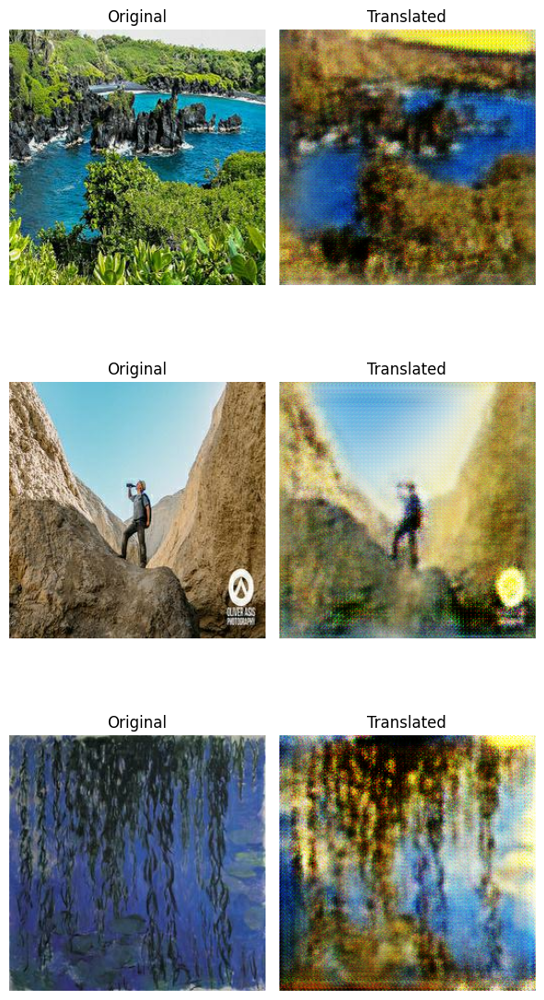

[Epoch 6/30] Train D=1.7181, G=6.0186 | Val D=2.4713, G=2.9354
[Epoch 7/30] Train D=1.7373, G=6.1091 | Val D=0.7380, G=5.0317
[Epoch 8/30] Train D=1.4401, G=6.1084 | Val D=1.0419, G=5.4931
[Epoch 9/30] Train D=1.4726, G=6.1998 | Val D=1.6606, G=3.2317
[Epoch 10/30] Train D=1.6631, G=6.5754 | Val D=1.9904, G=6.9186


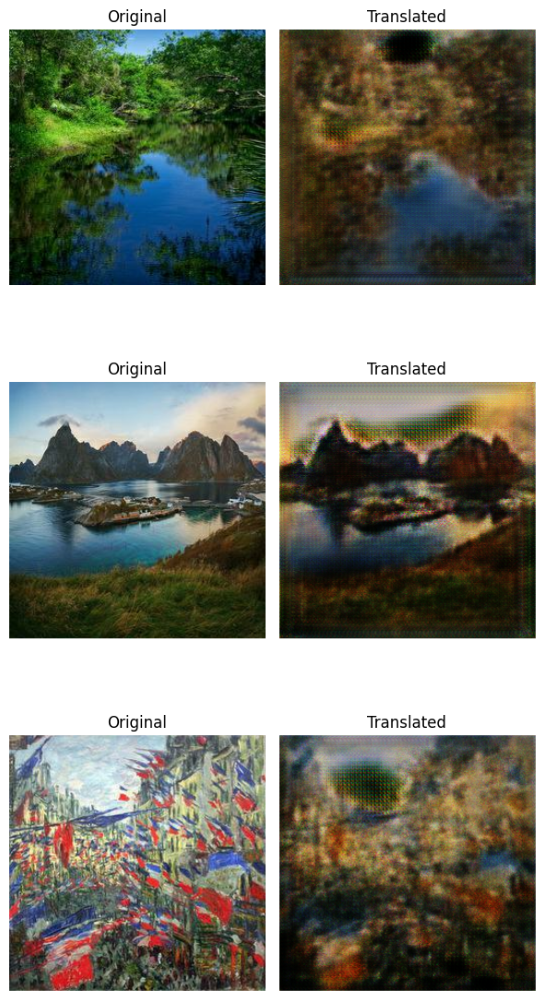

[Epoch 11/30] Train D=1.1033, G=5.8807 | Val D=1.8405, G=5.4247
[Epoch 12/30] Train D=1.4660, G=6.1867 | Val D=2.5842, G=2.7318
[Epoch 13/30] Train D=1.3477, G=6.4807 | Val D=0.8388, G=5.1870
[Epoch 14/30] Train D=1.3839, G=6.5427 | Val D=1.3048, G=5.2230
[Epoch 15/30] Train D=1.3474, G=6.2697 | Val D=1.5477, G=6.1022


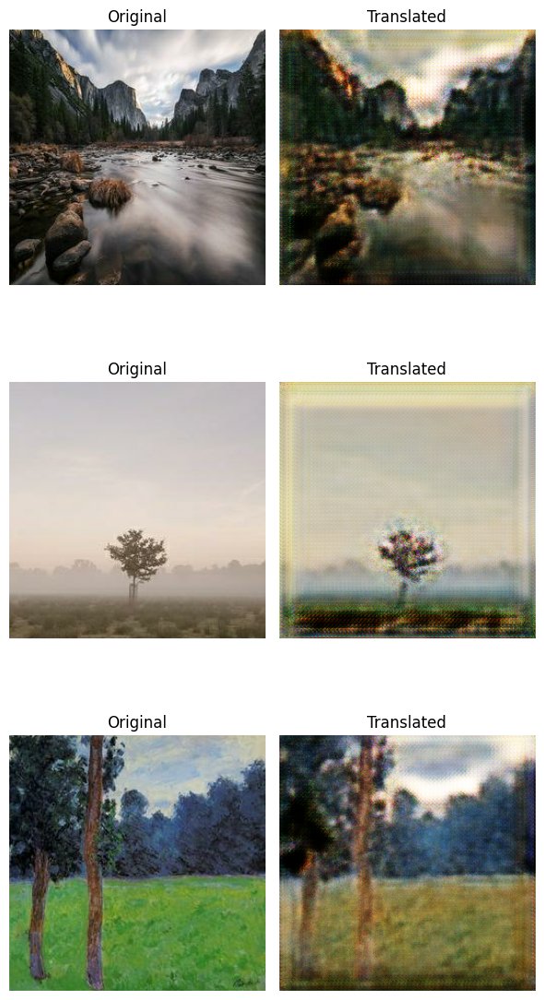

[Epoch 16/30] Train D=1.5156, G=6.5761 | Val D=0.8378, G=3.6061
[Epoch 17/30] Train D=1.4850, G=6.6124 | Val D=2.8988, G=7.5740
[Epoch 18/30] Train D=1.3312, G=7.3162 | Val D=2.0114, G=6.8061
[Epoch 19/30] Train D=1.3641, G=6.4223 | Val D=0.7880, G=4.4771
[Epoch 20/30] Train D=1.6146, G=6.5124 | Val D=1.1606, G=3.4754


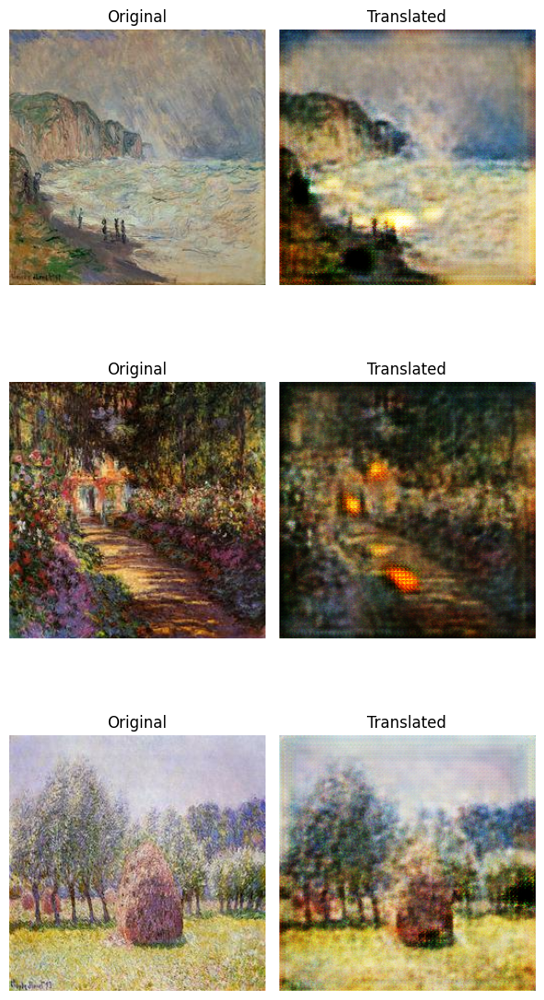

[Epoch 21/30] Train D=1.2447, G=6.4954 | Val D=3.4362, G=2.6212
[Epoch 22/30] Train D=1.4685, G=6.8090 | Val D=1.1686, G=3.4917
[Epoch 23/30] Train D=1.7230, G=7.0678 | Val D=0.4181, G=5.7612
[Epoch 24/30] Train D=1.6769, G=6.7652 | Val D=1.2418, G=3.6010
[Epoch 25/30] Train D=1.0505, G=5.9925 | Val D=1.3735, G=5.8867


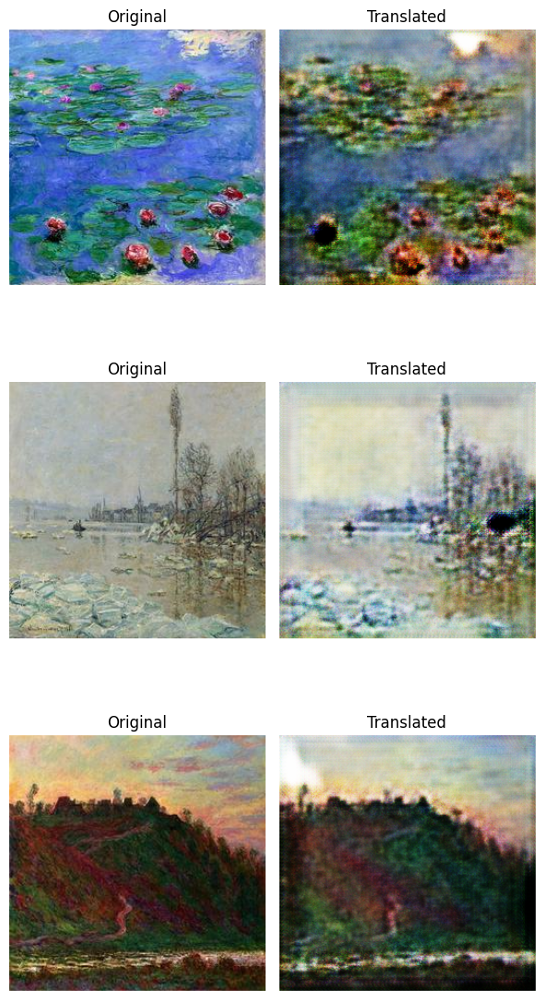

[Epoch 26/30] Train D=1.4573, G=6.5654 | Val D=1.1093, G=3.9890
[Epoch 27/30] Train D=1.6324, G=6.2403 | Val D=1.8008, G=2.8339
[Epoch 28/30] Train D=1.2896, G=7.1436 | Val D=0.8644, G=3.8441
[Epoch 29/30] Train D=1.3077, G=6.6763 | Val D=1.7447, G=3.3773
[Epoch 30/30] Train D=1.5460, G=6.6457 | Val D=2.3978, G=8.4011


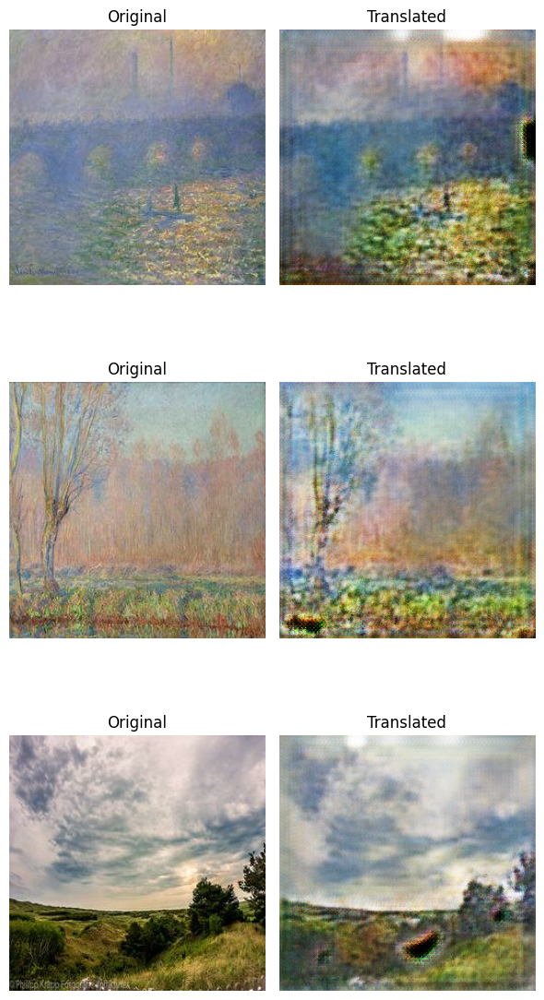

In [153]:
EPOCHS = 30
d_tr, g_tr, d_vl, g_vl = train_stargan_with_validation(
    train_ds,
    val_ds,
    generator=starG,
    discriminator=starD,
    g_optimizer=g_optimizer,
    d_optimizer=d_optimizer,
    epochs=EPOCHS,
    lambda_rec=10.0
)


# 8)Visualisation des pertes d'entraînement et de validation

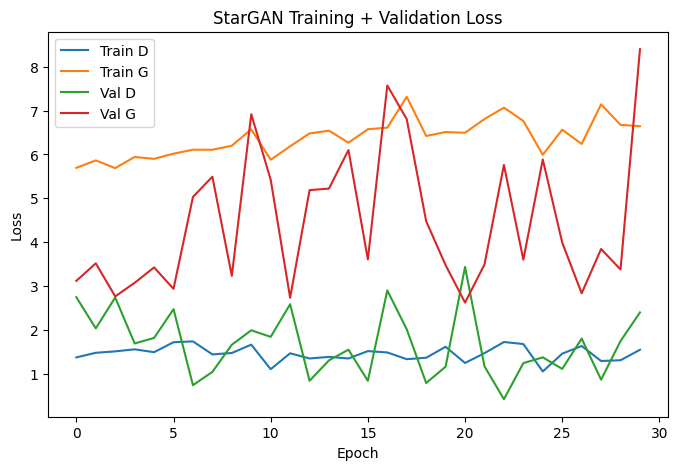

In [154]:
plt.figure(figsize=(8,5))
plt.plot(d_tr, label='Train D')
plt.plot(g_tr, label='Train G')
plt.plot(d_vl, label='Val D')
plt.plot(g_vl, label='Val G')
plt.title("StarGAN Training + Validation Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.show()


# 9) Test du model StarGAN

In [156]:
def visualize_stargan(generator, x, c_org, num_images=3):
    """
    Affiche x (image originale) par rapport à x_fake (image traduite dans un autre domaine).
    """
    # Calcul des labels cibles pour la traduction
    c_trg = 1.0 - c_org

    # Génération des images traduites
    x_fake = generator(x, c_trg, training=False)

    # Normalisation des valeurs des pixels pour l'affichage (plage [0, 1])
    x_real_disp = (x + 1) / 2.0
    x_fake_disp = (x_fake + 1) / 2.0

    # Nombre d'images à afficher (limité par le dataset)
    n = min(num_images, x.shape[0])

    # Configuration de la figure
    plt.figure(figsize=(6, 4 * n))
    for i in range(n):
        # Affichage des images originales
        plt.subplot(n, 2, 2 * i + 1)
        plt.imshow(x_real_disp[i].numpy())
        plt.title("Original")
        plt.axis('off')

        # Affichage des images traduites
        plt.subplot(n, 2, 2 * i + 2)
        plt.imshow(x_fake_disp[i].numpy())
        plt.title("Translated")
        plt.axis('off')

    # Ajustement de la mise en page
    plt.tight_layout()
    plt.show()


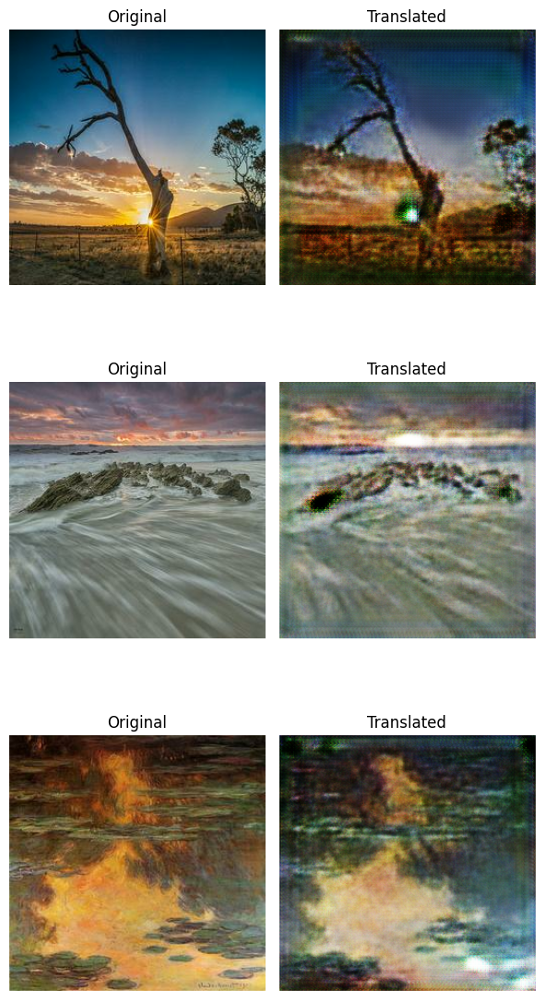

In [157]:
# Exemple d'appel
for (imgs, labels) in val_star_ds.take(1):
    visualize_stargan(starG, imgs, labels, num_images=3)
    break


logit (vrai/faux):
 [[-4.053648 ]
 [-1.7512021]
 [-3.7942648]]
domain_pred (Photo vs. Monet):
 [[-3.883867   4.0034165]
 [-3.6657493  1.5773065]
 [-3.7442582  3.667882 ]]
labels réels :
 [[0. 1.]
 [0. 1.]
 [0. 1.]]


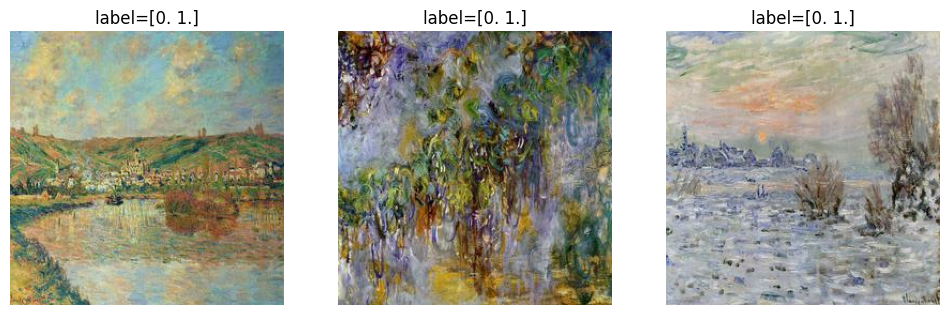

In [159]:
def test_discriminator_domains(discriminator, dataset, num_images=3):
    """
    Teste le discriminateur en affichant les résultats des prédictions
    (logit, prédiction de domaine, label réel) et visualise les images.
    """
    # Récupération d'un batch d'images et de labels
    for (imgs, labels) in dataset.take(1):
        pass

    # Limiter le nombre d'images au paramètre `num_images`
    imgs = imgs[:num_images]
    labels = labels[:num_images]

    # Sortie du discriminateur pour les images
    discriminator_output = discriminator(imgs, training=False)

    # Vérification si le discriminateur renvoie un ou deux résultats
    if isinstance(discriminator_output, tuple) and len(discriminator_output) == 2:
        logit, domain_pred = discriminator_output
    else:  # Supposer qu'il ne renvoie que les logits
        logit = discriminator_output
        domain_pred = None  # Ou une valeur par défaut

    # Affichage des logits (prédictions vrai/faux)
    print("Logit (vrai/faux) :\n", logit.numpy())

    # Affichage des prédictions de domaine uniquement si elles sont disponibles
    if domain_pred is not None:
        print("Prédiction de domaine (Photo vs. Monet) :\n", domain_pred.numpy())

    # Affichage des labels réels
    print("Labels réels :\n", labels.numpy())

    # Normalisation des images pour l'affichage
    imgs_disp = (imgs + 1.0) / 2.0

    # Visualisation des images avec leurs labels
    plt.figure(figsize=(4 * num_images, 4))
    for i in range(num_images):
        plt.subplot(1, num_images, i + 1)
        plt.imshow(imgs_disp[i].numpy())
        plt.axis('off')
        plt.title(f"Label réel = {labels[i].numpy()}")
    plt.show()

# Exemple : tester le discriminateur sur un lot de données de validation
test_discriminator_domains(starD, val_ds, num_images=3)  # Passer `starD` au lieu de `discriminator`


In [160]:
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np

def show_generated_vs_real(generator,
                           source_dataset,  # ex: photo_ds_labeled
                           target_dataset,  # ex: monet_ds_labeled
                           num_images=3):
    """
    - Pioche `num_images` images dans 'source_dataset' (ex: Photo),
    - Les convertit vers l'autre domaine (ex: Monet) avec le générateur,
    - Pioche `num_images` vraies images dans 'target_dataset' (ex: Monet),
    - Affiche en 3 lignes:
       1) Source
       2) Généré
       3) Vrai du domaine cible
    """

    # --- Récupérer un batch source ---
    for (src_imgs, src_label) in source_dataset.take(1):
        pass  # src_imgs.shape = (batch,256,256,3), src_label.shape=(batch,2)

    # On ne prend que num_images
    src_imgs = src_imgs[:num_images]
    src_label = src_label[:num_images]

    # Déterminer le label cible (inversion simple)
    # Suppose [1,0] => [0,1], [0,1] => [1,0]
    c_trg = 1.0 - src_label

    # Générer
    gen_imgs = generator(src_imgs, c_trg, training=False)

    # --- Récupérer un batch cible (vrais Monet si c_trg=Monet) ---
    for (tgt_imgs, tgt_label) in target_dataset.take(1):
        pass
    tgt_imgs = tgt_imgs[:num_images]

    # Remettre en [0,1] pour affichage
    src_imgs_disp = (src_imgs + 1)/2.0
    gen_imgs_disp = (gen_imgs + 1)/2.0
    tgt_imgs_disp = (tgt_imgs + 1)/2.0

    # --- Affichage ---
    # On fait un subplot de size = (num_images x 3), en colonnes
    fig, axs = plt.subplots(num_images, 3, figsize=(9, 3*num_images))
    for i in range(num_images):
        # 1) Source
        axs[i, 0].imshow(src_imgs_disp[i].numpy())
        axs[i, 0].set_title("Source")
        axs[i, 0].axis('off')

        # 2) Généré
        axs[i, 1].imshow(gen_imgs_disp[i].numpy())
        axs[i, 1].set_title("Généré")
        axs[i, 1].axis('off')

        # 3) Vrai (cible)
        if i < tgt_imgs_disp.shape[0]:
            axs[i, 2].imshow(tgt_imgs_disp[i].numpy())
            axs[i, 2].set_title("Vrai (cible)")
            axs[i, 2].axis('off')

    plt.tight_layout()
    plt.show()


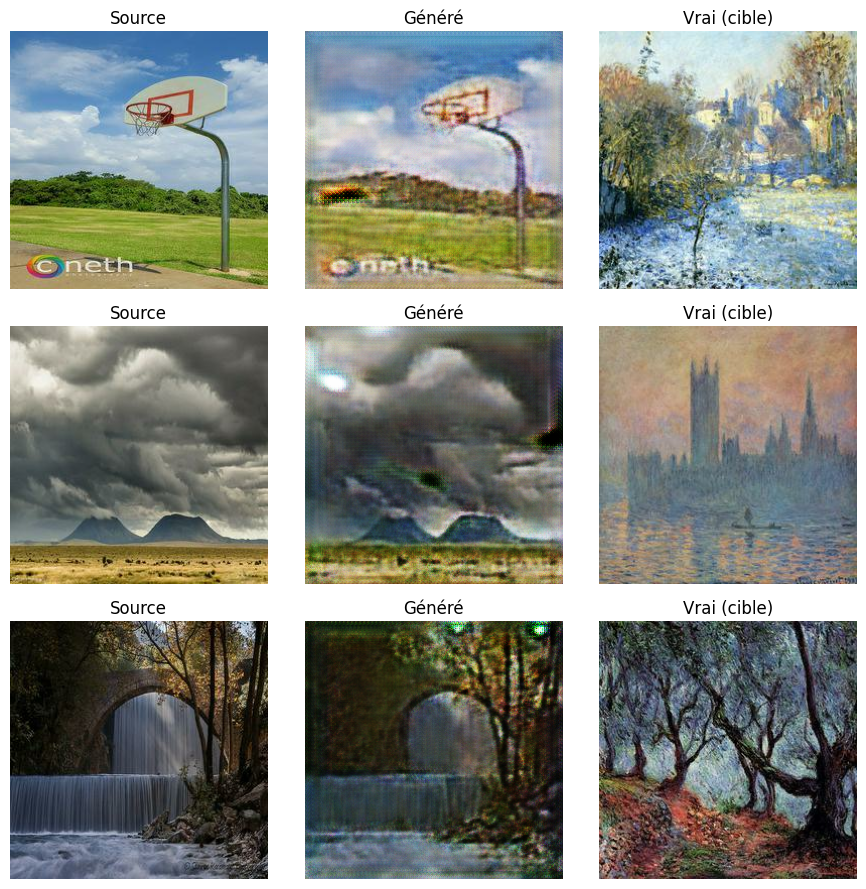

In [161]:
show_generated_vs_real(
    generator=starG,
    source_dataset=photo_ds_labeled.batch(8),  # on batch un peu
    target_dataset=monet_ds_labeled.batch(8),
    num_images=3
)


# 10) Sauvegarde des modèles StarGAN

In [155]:
# ====================================================
# 11) Sauvegarde des modèles
# ====================================================
generator.save("/content/drive/MyDrive/GAN_Monet_Kaggle/Model/starGAN/generator_saved_model")  # Crée un dossier "generator_saved_model"
discriminator.save("/content/drive/MyDrive/GAN_Monet_Kaggle/Model/starGAN/discriminator_saved_model")


In [ ]:

# Charger les poids
starG.load_weights("/content/drive/MyDrive/GAN_Monet_Kaggle/Model/starGAN/generator_saved_model/generator_weights.h5")
starD.load_weights("/content/drive/MyDrive/GAN_Monet_Kaggle/Model/starGAN/content/discriminator_saved_model")
